## Scanpy Analysis

In [1]:
%config InlineBackend.figure_formats = ["retina"]  # increase resolution on retina screens
import numpy as np
import pandas as pd
import warnings
import sys
warnings.filterwarnings("ignore")
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
#import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors
import scanpy as sc
import seaborn as sns
import anndata as ad
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.n_jobs = 23

scanpy==1.9.1 anndata==0.9.2 umap==0.5.3 numpy==1.23.5 scipy==1.11.1 pandas==1.5.2 scikit-learn==1.3.0 statsmodels==0.14.0 python-igraph==0.10.6 pynndescent==0.5.10


In [2]:
from gtfparse import read_gtf

In [3]:
%load_ext rpy2.ipython

INFO:rpy2.situation:cffi mode is CFFI_MODE.ANY
INFO:rpy2.situation:R home found: /scratch/prj/sangrithi_lab/programs/miniconda3/envs/MS_Conda5/lib/R
INFO:rpy2.situation:R library path: 
INFO:rpy2.situation:LD_LIBRARY_PATH: 
INFO:rpy2.rinterface_lib.embedded:Default options to initialize R: rpy2, --quiet, --no-save
INFO:rpy2.rinterface_lib.embedded:R is already initialized. No need to initialize.


In [4]:
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 100)#None

In [5]:
plt.rcParams.update({})
# Say, "the default sans-serif font is COMIC SANS"
matplotlib.rcParams['font.sans-serif'] = "Arial"
# Then, "ALWAYS use sans-serif fonts"
matplotlib.rcParams['font.family'] = "sans-serif"
sc.settings.set_figure_params(dpi=125, dpi_save=300, format="pdf", frameon=False)
sc.settings.figdir = '/users/k2142342/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_17Jul23/Figures/'
# Set context to `"paper"`
sns.set_context("paper", font_scale=1, rc={"font.size":16,"axes.labelsize":16,"axes.titlesize":20})

In [6]:
heatcolors_wr = matplotlib.colors.LinearSegmentedColormap.from_list("", ["white", "#FFF5F0", "#FEE0D2", "#FCBBA1", 
                                                                         "#FC9272", "#FB6A4A", "#EF3B2C", 
                                                                         "#CB181D", "#A50F15", "#67000D"])
heatcolors = matplotlib.colors.LinearSegmentedColormap.from_list("", ["gray", "#000004FF", "#330A5FFF", "#781C6DFF",
                                                                      "#BB3754FF", "#ED6925FF", 
                                                                      "#FCB519FF", "#FCFFA4FF"])

In [7]:
#%%R
#heatcolour_wr <- colorRampPalette(c("white", "#FFF5F0", "#FEE0D2", "#FCBBA1","#FC9272", "#FB6A4A", "#EF3B2C","#CB181D", "#A50F15", "#67000D"))(100)
#show_col(heatcolour_wr)

In [8]:
%%R
require(tidyverse)
require(dplyr)
require(tidyr)
options(mc.cores = 23L)
require(magrittr)
#library(scatterpie)
require(extrafont)
require(scales)
require(viridis)
require(viridisLite)
require(gridExtra)
options(dplyr.width = 200)
#options(repr.matrix.max.cols=500, repr.matrix.max.rows=100)

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.2     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ ggplot2   3.4.2     ✔ tibble    3.2.1
✔ lubridate 1.9.2     ✔ tidyr     1.3.0
✔ purrr     1.0.1     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors



Attaching package: ‘magrittr’



    set_names



    extract





Attaching package: ‘scales’



    discard



    col_factor




Attaching package: ‘viridis’



    viridis_pal



Attaching package: ‘gridExtra’



    combine




In [9]:
## Load the Mouse GTF file
gtf_df = read_gtf("/users/k2142342/Lab_Sangrithi/reference/annot/Mus_musculus.GRCm38/Mus_musculus.GRCm38.102.chr.gtf")

INFO:root:Extracted GTF attributes: ['gene_id', 'gene_version', 'gene_name', 'gene_source', 'gene_biotype', 'havana_gene', 'havana_gene_version', 'transcript_id', 'transcript_version', 'transcript_name', 'transcript_source', 'transcript_biotype', 'havana_transcript', 'havana_transcript_version', 'tag', 'transcript_support_level', 'exon_number', 'exon_id', 'exon_version', 'ccds_id', 'protein_id', 'protein_version']


In [10]:
genes = gtf_df[gtf_df.transcript_biotype.isin(['protein_coding',
       'antisense', 'lincRNA',
       'TR_V_gene',
       'TR_V_pseudogene', 'TR_D_gene', 'TR_J_gene', 'TR_C_gene',
       'TR_J_pseudogene', 'IG_LV_gene', 'IG_V_gene', 'IG_V_pseudogene',
       'IG_J_gene', 'IG_C_gene', 'IG_C_pseudogene',
       'IG_D_gene', 'IG_D_pseudogene', 'IG_pseudogene'])].gene_id.unique()

In [11]:
len(genes)

31434

In [12]:
genes_df = gtf_df[gtf_df.transcript_biotype.isin(['protein_coding',
       'antisense', 'lincRNA',
        'TR_V_gene',
       'TR_V_pseudogene', 'TR_D_gene', 'TR_J_gene', 'TR_C_gene',
       'TR_J_pseudogene', 'IG_LV_gene', 'IG_V_gene', 'IG_V_pseudogene',
       'IG_J_gene', 'IG_C_gene', 'IG_C_pseudogene',
       'IG_D_gene', 'IG_D_pseudogene', 'IG_pseudogene'])].reset_index(drop = True)

In [13]:
genes_df

,seqname,source,feature,start,end,score,strand,frame,gene_id,gene_version,gene_name,gene_source,gene_biotype,havana_gene,havana_gene_version,transcript_id,transcript_version,transcript_name,transcript_source,transcript_biotype,havana_transcript,havana_transcript_version,tag,transcript_support_level,exon_number,exon_id,exon_version,ccds_id,protein_id,protein_version
0,1,ensembl_havana,transcript,3214482,3671498,NaN,-,0,ENSMUSG00000051951,5,Xkr4,ensembl_havana,protein_coding,OTTMUSG00000026353,2,ENSMUST00000070533,4,Xkr4-201,ensembl_havana,protein_coding,OTTMUST00000065166,1,"CCDS,basic",1,,,,CCDS14803,,
1,1,ensembl_havana,exon,3670552,3671498,NaN,-,0,ENSMUSG00000051951,5,Xkr4,ensembl_havana,protein_coding,OTTMUSG00000026353,2,ENSMUST00000070533,4,Xkr4-201,ensembl_havana,protein_coding,OTTMUST00000065166,1,"CCDS,basic",1,1,ENSMUSE00000485541,3,CCDS14803,,
2,1,ensembl_havana,CDS,3670552,3671348,NaN,-,0,ENSMUSG00000051951,5,Xkr4,ensembl_havana,protein_coding,OTTMUSG00000026353,2,ENSMUST00000070533,4,Xkr4-201,ensembl_havana,protein_coding,OTTMUST00000065166,1,"CCDS,basic",1,1,,,CCDS14803,ENSMUSP00000070648,4
3,1,ensembl_havana,start_codon,3671346,3671348,NaN,-,0,ENSMUSG00000051951,5,Xkr4,ensembl_havana,protein_coding,OTTMUSG00000026353,2,ENSMUST00000070533,4,Xkr4-201,ensembl_havana,protein_coding,OTTMUST00000065166,1,"CCDS,basic",1,1,,,CCDS14803,,
4,1,ensembl_havana,exon,3421702,3421901,NaN,-,0,ENSMUSG00000051951,5,Xkr4,ensembl_havana,protein_coding,OTTMUSG00000026353,2,ENSMUST00000070533,4,Xkr4-201,ensembl_havana,protein_coding,OTTMUST00000065166,1,"CCDS,basic",1,2,ENSMUSE00000449517,3,CCDS14803,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1387326,MT,insdc,stop_codon,13552,13554,NaN,-,0,ENSMUSG00000064368,1,mt-Nd6,insdc,protein_coding,,,ENSMUST00000082419,1,mt-Nd6-201,insdc,protein_coding,,,basic,NA,1,,,,,
1387327,MT,insdc,transcript,14145,15288,NaN,+,0,ENSMUSG00000064370,1,mt-Cytb,insdc,protein_coding,,,ENSMUST00000082421,1,mt-Cytb-201,insdc,protein_coding,,,basic,NA,,,,,,
1387328,MT,insdc,exon,14145,15288,NaN,+,0,ENSMUSG00000064370,1,mt-Cytb,insdc,protein_coding,,,ENSMUST00000082421,1,mt-Cytb-201,insdc,protein_coding,,,basic,NA,1,ENSMUSE00000521548,1,,,
1387329,MT,insdc,CDS,14145,15288,NaN,+,0,ENSMUSG00000064370,1,mt-Cytb,insdc,protein_coding,,,ENSMUST00000082421,1,mt-Cytb-201,insdc,protein_coding,,,basic,NA,1,,,,ENSMUSP00000081003,1


In [14]:
#genes_df.to_csv("/users/k2142342/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_9Feb23/genes_df.csv")

In [15]:
#genes_df = pd.read_csv("/users/k2142342/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_9Feb23/genes_df.csv", index_col=0)

In [16]:
genes = genes_df.gene_id.unique()

In [17]:
len(genes_df.gene_id[genes_df.seqname.isin(['MT'])].unique())

13

In [18]:
%%R -o countdataSC
# Load the count data
countdataSC <- read.table("~/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_17Jul23/total/Total_counts_Pos_only.txt", header=TRUE, row.names=1)
#countdataSC <- read.table("~/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_17Jul23/total/Total_counts_PosandNeg.txt", header=TRUE, row.names=1)
dim(countdataSC)

[1] 55401   738


In [19]:
%%R
colnames(countdataSC) %>% head() %>% print()
dim(countdataSC)
colnames(countdataSC) <- gsub("\\.", "_", colnames(countdataSC))
dim(countdataSC)

[1] "E10.GFP.pos.F1.10" "E10.GFP.pos.F1.11" "E10.GFP.pos.F1.12"
[4] "E10.GFP.pos.F1.13" "E10.GFP.pos.F1.14" "E10.GFP.pos.F1.15"
[1] 55401   738


In [20]:
%%R
colnames(countdataSC) %>% head() %>% print()
#head(countdataSC)

[1] "E10_GFP_pos_F1_10" "E10_GFP_pos_F1_11" "E10_GFP_pos_F1_12"
[4] "E10_GFP_pos_F1_13" "E10_GFP_pos_F1_14" "E10_GFP_pos_F1_15"


In [21]:
%%R -o countdataSCMeta
countdataSCMeta <- read.table("~/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_17Jul23/BAM_LIST_18Jul23_Metadata.txt",
                             sep = '\t',
                             header = T)


rownames(countdataSCMeta) <- countdataSCMeta$sample
colnames(countdataSCMeta)[1] = "Cell"


In [22]:
%%R
countdataSCMeta %>% group_by(age, sex) %>% tally()

# A tibble: 14 × 3
# Groups:   age [7]
   age   sex        n
   <chr> <chr>  <int>
 1 E10.5 female    48
 2 E10.5 male      48
 3 E11.5 female    48
 4 E11.5 male      48
 5 E12.5 female    48
 6 E12.5 male      45
 7 E13.5 female    48
 8 E13.5 male      48
 9 E14.5 female    48
10 E14.5 male      48
11 E15.5 female    48
12 E15.5 male      72
13 E16.5 female    72
14 E16.5 male      72


In [23]:
%%R -o countdataSC -o obs_names -o var_names -i genes
# subset rownames
countdataSC <- countdataSC[rownames(countdataSC) %in% genes, ]
obs_names <- colnames(countdataSC)
var_names <- rownames(countdataSC)
countdataSC <- as.matrix(countdataSC)
print(dim(countdataSC[rownames(countdataSC) %in% genes, ]))

[1] 31434   738


# Genome1 and 2 counts

In [24]:
%%R -o countdataSC_g1 -o countdataSC_g2
# Load the count data
#countdataSC_g1 <- read.table("~/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCount_OUT_18Jul21/E125_145_counts_genome1.txt", header=TRUE, row.names=1)
#countdataSC_g2 <- read.table("~/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCount_OUT_18Jul21/E125_145_counts_genome2.txt", header=TRUE, row.names=1)
countdataSC_g1 <- read.table("/users/k2142342/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_17Jul23/genome1/Total_counts_genome1_Pos_only.txt", header=TRUE, row.names=1)
countdataSC_g2 <- read.table("/users/k2142342/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_17Jul23/genome2/Total_counts_genome2_Pos_only.txt", header=TRUE, row.names=1)

In [25]:
%%R
colnames(countdataSC_g1) <- gsub("\\.", "_", colnames(countdataSC_g1))
colnames(countdataSC_g2) <- gsub("\\.", "_", colnames(countdataSC_g2))

dim(countdataSC_g1) %>% print()
dim(countdataSC_g2) %>% print()

[1] 55401   738
[1] 55401   738


In [26]:
%%R -o countdataSC_g1 -o obs_names_g1 -o var_names_g1 -i genes
# subset rownames
countdataSC_g1 <- countdataSC_g1[rownames(countdataSC_g1) %in% genes, ]
obs_names_g1 <- colnames(countdataSC_g1)
var_names_g1 <- rownames(countdataSC_g1)
countdataSC_g1 <- as.matrix(countdataSC_g1)
print(dim(countdataSC_g1[rownames(countdataSC_g1) %in% genes, ]))

[1] 31434   738


In [27]:
%%R 
#head(countdataSC_g1) 
colnames(countdataSC_g1) %in% rownames(countdataSCMeta) %>% table()
#colnames(countdataSC_g1)

.
TRUE 
 738 


In [28]:
%%R -o countdataSC_g2 -o obs_names_g2 -o var_names_g2 -i genes
# subset rownames
countdataSC_g2 <- countdataSC_g2[rownames(countdataSC_g2) %in% genes, ]
obs_names_g2 <- colnames(countdataSC_g2)
var_names_g2 <- rownames(countdataSC_g2)
countdataSC_g2 <- as.matrix(countdataSC_g2)
print(dim(countdataSC_g2[rownames(countdataSC_g2) %in% genes, ]))

[1] 31434   738


In [29]:
%%R
is.na(countdataSC_g1) %>% table()
is.na(countdataSC_g2) %>% table()

.
   FALSE 
23198292 


# SCANPY

In [30]:
gcAnndata = sc.AnnData(X = countdataSC.T, obs = obs_names, var = var_names)

In [31]:
# Read in saved gcAnndata
#gcAnndata=sc.read_h5ad("/users/k2142342/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_17Jul23/gcAnndata_17Jul23.h5ad")
#gcAnndata

In [32]:
gcAnndata.obs.rename(columns={0:'Sample'}, inplace=True)
gcAnndata.var.rename(columns={0:'geneid'}, inplace=True)

In [33]:
gcAnndata.var.index = gcAnndata.var.geneid.to_list()
gcAnndata.obs.index = gcAnndata.obs.Sample.to_list()

In [34]:
annot = sc.queries.biomart_annotations(
    "mmusculus",
    ["ensembl_gene_id", "start_position", "end_position", "chromosome_name", "external_gene_name"],
    host="nov2020.archive.ensembl.org",
    use_cache='TRUE',
    ).set_index("ensembl_gene_id")

In [37]:
gcAnndata.var[annot.columns] = annot

In [39]:
gcAnndata.var.index = gcAnndata.var.geneid.tolist()

In [40]:
gcAnndata

AnnData object with n_obs × n_vars = 738 × 31434
    obs: 'Sample'
    var: 'geneid', 'start_position', 'end_position', 'chromosome_name', 'external_gene_name'

In [41]:
gcAnndata.var_names_make_unique()

In [42]:
gcAnndata.n_obs

738

In [43]:
gcAnndata.var.chromosome_name=='MT'

ENSMUSG00000051951    False
ENSMUSG00000089699    False
ENSMUSG00000102343    False
ENSMUSG00000025900    False
ENSMUSG00000025902    False
                      ...  
ENSMUSG00000065947     True
ENSMUSG00000064363     True
ENSMUSG00000064367     True
ENSMUSG00000064368     True
ENSMUSG00000064370     True
Name: chromosome_name, Length: 31434, dtype: bool

In [44]:
gcAnndata.var['mt'] = gcAnndata.var.chromosome_name=='MT' # annotate the group of mitochondrial genes as 'mt'
gcAnndata.var['mt']

ENSMUSG00000051951    False
ENSMUSG00000089699    False
ENSMUSG00000102343    False
ENSMUSG00000025900    False
ENSMUSG00000025902    False
                      ...  
ENSMUSG00000065947     True
ENSMUSG00000064363     True
ENSMUSG00000064367     True
ENSMUSG00000064368     True
ENSMUSG00000064370     True
Name: mt, Length: 31434, dtype: bool

In [45]:
sc.pp.calculate_qc_metrics(gcAnndata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [46]:
gcAnndata.obs['sex'] = countdataSCMeta['sex']

In [47]:
gcAnndata.obs['stage'] = countdataSCMeta['age']

In [48]:
gcAnndata.obs['Embryo'] = countdataSCMeta['embryo']

In [50]:
gcAnndata.obs['stage_sex'] = gcAnndata.obs.sex.astype('str') + "_" + gcAnndata.obs.stage.astype('str')

In [51]:
gcAnndata.obs

,Sample,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,sex,stage,Embryo,stage_sex
E10_GFP_pos_F1_10,E10_GFP_pos_F1_10,8707,715292,918,0.128339,female,E10.5,F1,female_E10.5
E10_GFP_pos_F1_11,E10_GFP_pos_F1_11,8473,1564689,5792,0.370169,female,E10.5,F1,female_E10.5
E10_GFP_pos_F1_12,E10_GFP_pos_F1_12,8206,2310070,3992,0.172809,female,E10.5,F1,female_E10.5
E10_GFP_pos_F1_13,E10_GFP_pos_F1_13,10345,1608779,6207,0.385821,female,E10.5,F1,female_E10.5
E10_GFP_pos_F1_14,E10_GFP_pos_F1_14,8338,1320374,5065,0.383603,female,E10.5,F1,female_E10.5
...,...,...,...,...,...,...,...,...,...
M4_GFPP_P2_B6,M4_GFPP_P2_B6,5273,78485,949,1.209148,male,E12.5,M4,male_E12.5
M4_GFPP_P2_B7,M4_GFPP_P2_B7,6595,2647587,22935,0.866260,male,E12.5,M4,male_E12.5
M4_GFPP_P2_B8,M4_GFPP_P2_B8,5555,1920124,20754,1.080868,male,E12.5,M4,male_E12.5
M4_GFPP_P2_B9,M4_GFPP_P2_B9,5391,1287828,9147,0.710266,male,E12.5,M4,male_E12.5


In [52]:
gcAnndata

AnnData object with n_obs × n_vars = 738 × 31434
    obs: 'Sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sex', 'stage', 'Embryo', 'stage_sex'
    var: 'geneid', 'start_position', 'end_position', 'chromosome_name', 'external_gene_name', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [53]:
gcAnndata.obs['stage_sex'].value_counts()

female_E16.5    72
male_E16.5      71
male_E15.5      70
female_E10.5    48
male_E10.5      48
male_E11.5      48
female_E11.5    48
female_E12.5    48
female_E13.5    48
male_E13.5      48
male_E14.5      48
female_E14.5    48
female_E15.5    48
male_E12.5      45
Name: stage_sex, dtype: int64

In [54]:
gcAnndata.obs['sex'].head()

E10_GFP_pos_F1_10    female
E10_GFP_pos_F1_11    female
E10_GFP_pos_F1_12    female
E10_GFP_pos_F1_13    female
E10_GFP_pos_F1_14    female
Name: sex, dtype: object

In [57]:
gcAnndata.obs['CellID'] = gcAnndata.obs.index.tolist()

In [58]:
gcAnndata.var['Gene'] = gcAnndata.var.index.tolist()

... storing 'sex' as categorical
... storing 'stage' as categorical
... storing 'Embryo' as categorical
... storing 'stage_sex' as categorical
... storing 'chromosome_name' as categorical
... storing 'external_gene_name' as categorical


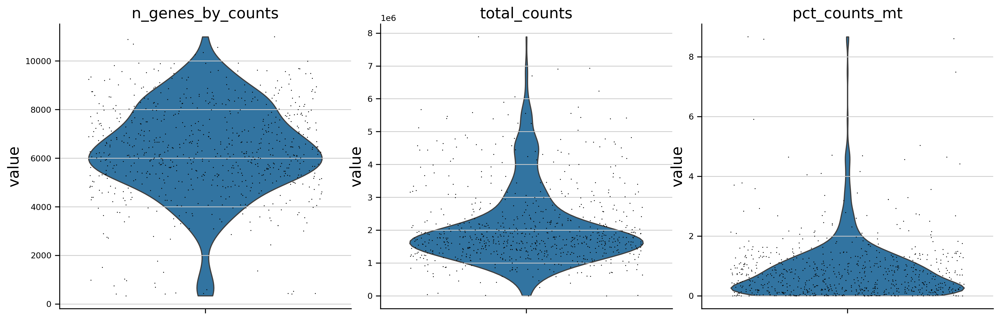

In [59]:
sc.pl.violin(gcAnndata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

In [61]:
sc.pp.filter_cells(gcAnndata, min_genes = 3500)
sc.pp.filter_cells(gcAnndata, max_genes = 10000)
sc.pp.filter_cells(gcAnndata, min_counts = 500000)
sc.pp.filter_genes(gcAnndata, min_cells = 5)
gcAnndata = gcAnndata[gcAnndata.obs['pct_counts_mt'] < 5, :]

filtered out 40 cells that have less than 3500 genes expressed
filtered out 6 cells that have more than 10000 genes expressed
filtered out 7 cells that have less than 500000 counts
filtered out 10260 genes that are detected in less than 5 cells


In [ ]:
#gcAnndata.obs.to_csv("/users/k2142342/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_17Jul23/gcAnndata_obs.csv")

In [ ]:
# Retain same cells for allele-specific analyses
#keep = gcAnndata.obs.Sample
#keep.to_csv(".../keep.csv")

In [63]:
gcAnndata.layers["counts"] = gcAnndata[gcAnndata.obs_names, gcAnndata.var_names].X.copy()


In [64]:
gcAnndata

AnnData object with n_obs × n_vars = 681 × 21174
    obs: 'Sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sex', 'stage', 'Embryo', 'stage_sex', 'CellID', 'n_genes', 'n_counts'
    var: 'geneid', 'start_position', 'end_position', 'chromosome_name', 'external_gene_name', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Gene', 'n_cells'
    layers: 'counts'

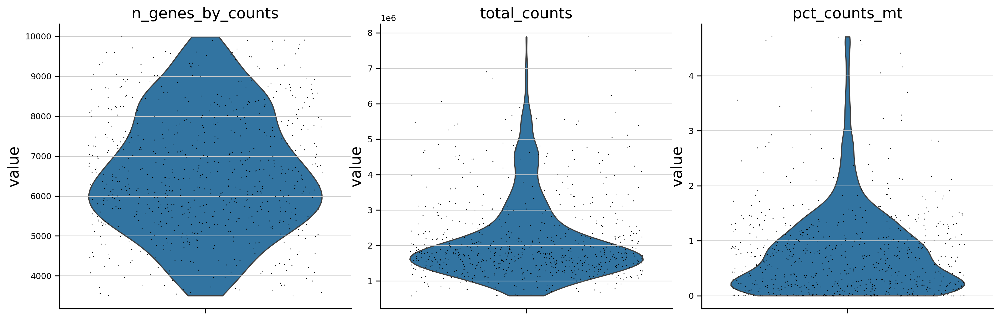

In [65]:
sc.pl.violin(gcAnndata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

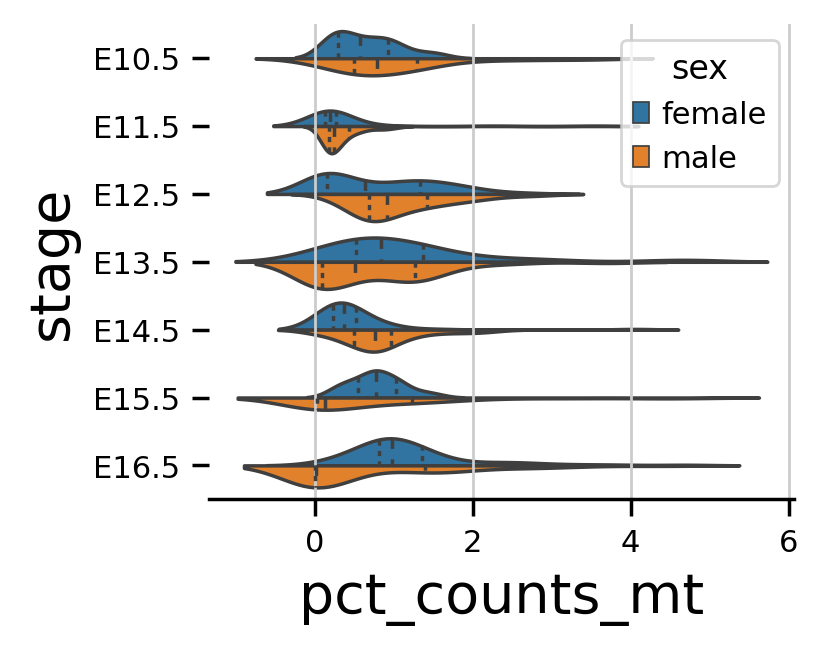

In [66]:
plt.rcParams['figure.figsize'] = [3, 2.5]
svm = sns.violinplot(data=gcAnndata.obs, y="stage", x="pct_counts_mt", hue="sex", split=True, inner="quart", linewidth=1);
sns.despine(left=True)
figure = svm.get_figure()    
#figure.savefig(".../mito_counts2.png", dpi=300)

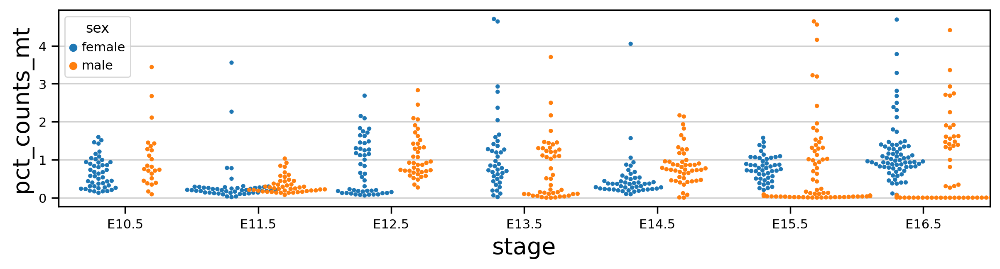

In [67]:
plt.rcParams['figure.figsize'] = [11.5, 2.5]
svm = sns.swarmplot(data=gcAnndata.obs, x="stage", y="pct_counts_mt", hue="sex", dodge=True, s = 3, legend=True);
figure = svm.get_figure()    
#figure.savefig(".../mito_counts.png", dpi=300)

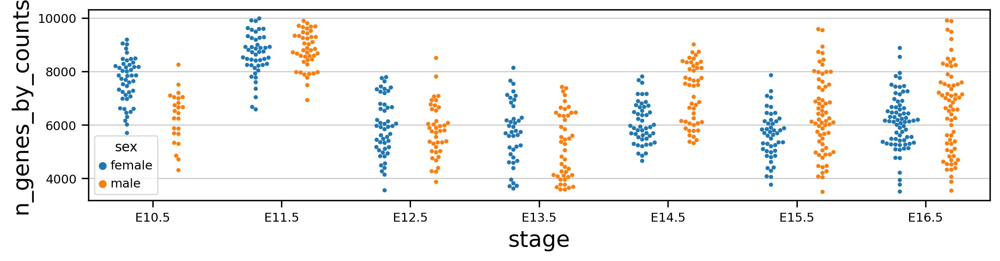

In [68]:
plt.rcParams['figure.figsize'] = [11.5, 2.5]
svm = sns.swarmplot(data=gcAnndata.obs, x="stage", y="n_genes_by_counts", hue="sex", s = 3, dodge=True);
figure = svm.get_figure()    
#figure.savefig(".../n_genes_by_counts.png", dpi=300)

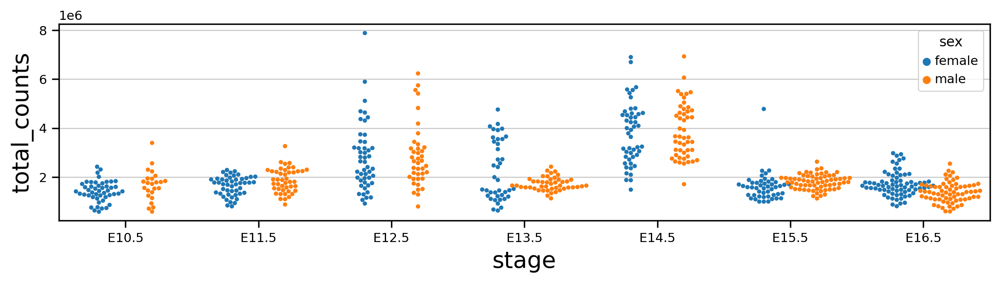

In [70]:
plt.rcParams['figure.figsize'] = [11.5, 2.5]
svm = sns.swarmplot(data=gcAnndata.obs, x = "stage", y = "total_counts", hue = "sex", s = 3, dodge = True);
figure = svm.get_figure()    
#figure.savefig(".../total_counts.png", dpi=300)

In [71]:
plt.rcParams['figure.figsize'] = [5, 5]

In [72]:
gcAnndata.raw = gcAnndata

In [73]:
sc.pp.normalize_total(gcAnndata, exclude_highly_expressed = True, max_fraction = 0.10, target_sum=1e4)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
[]
    finished (0:00:00)


In [74]:
sc.pp.log1p(gcAnndata)

In [75]:
sc.pp.highly_variable_genes(gcAnndata, flavor='seurat_v3', n_top_genes=800)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


In [76]:
gcAnndata.var['highly_variable'].value_counts()

False    20374
True       800
Name: highly_variable, dtype: int64

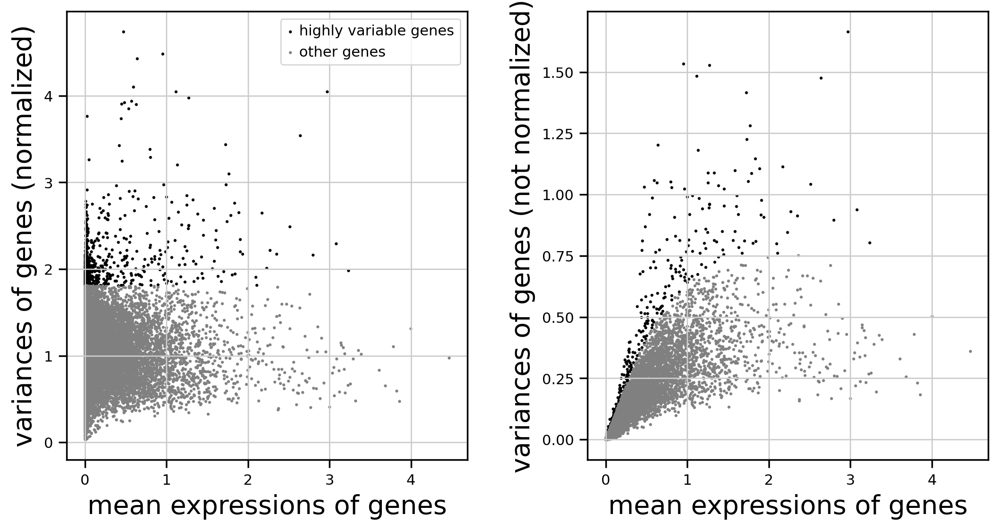

In [77]:
sc.pl.highly_variable_genes(gcAnndata)

In [78]:
sc.tl.pca(gcAnndata, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


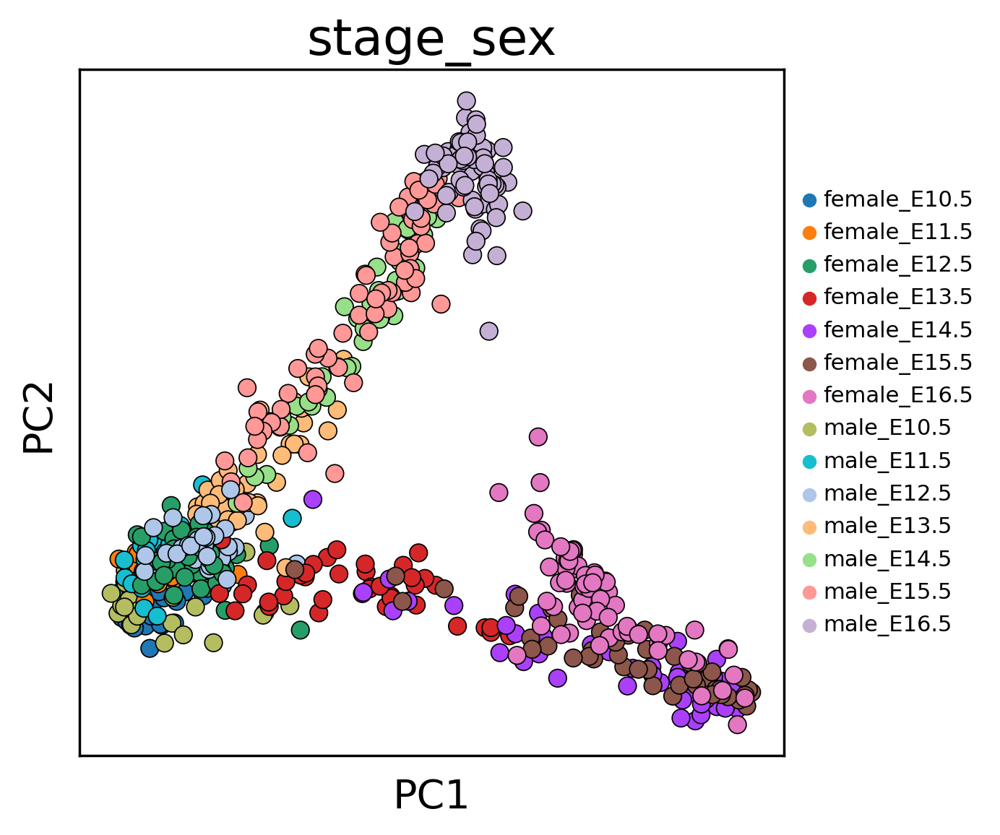

In [79]:
sc.pl.pca(gcAnndata, color=['stage_sex'], size=200, ec="black", linewidth=0.5, frameon=True)#

In [80]:
sc.pp.neighbors(gcAnndata, n_neighbors=5, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


In [81]:
sc.tl.leiden(gcAnndata, resolution = 0.7, random_state = 55063) # Perform clustering

running Leiden clustering
    finished: found 15 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


In [82]:
sc.tl.umap(gcAnndata, random_state = 55063)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


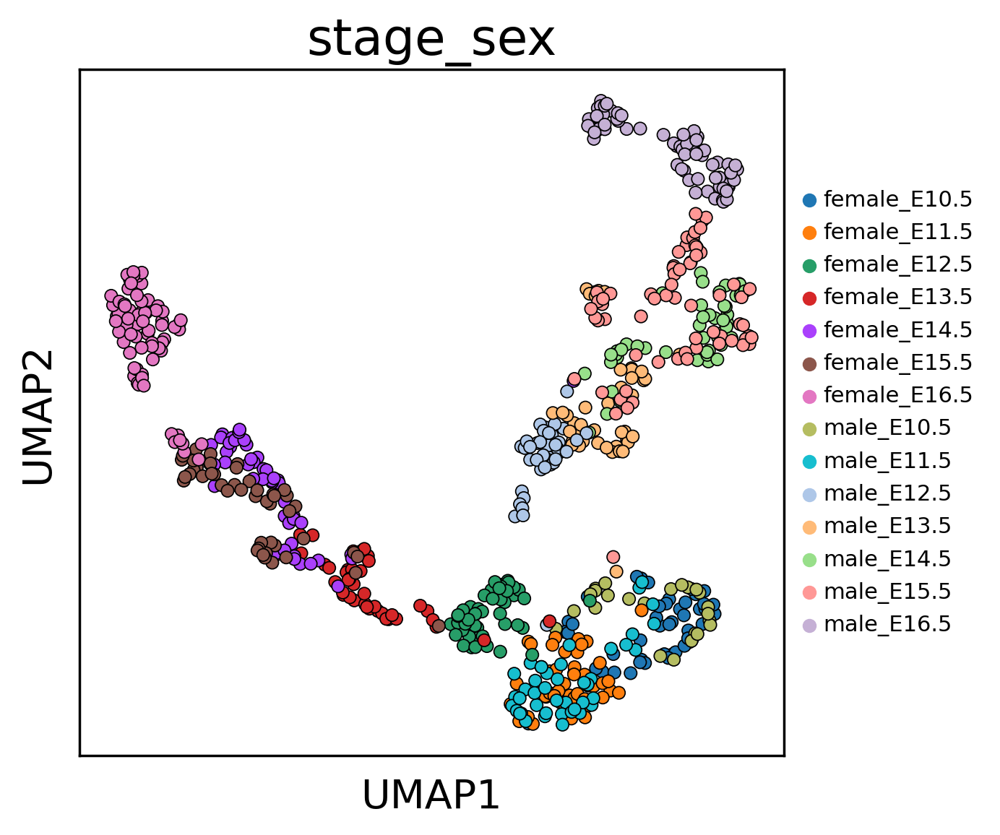

In [83]:
sc.pl.umap(gcAnndata, color=['stage_sex'], size=100, ec="black", linewidth=0.5, frameon=True)

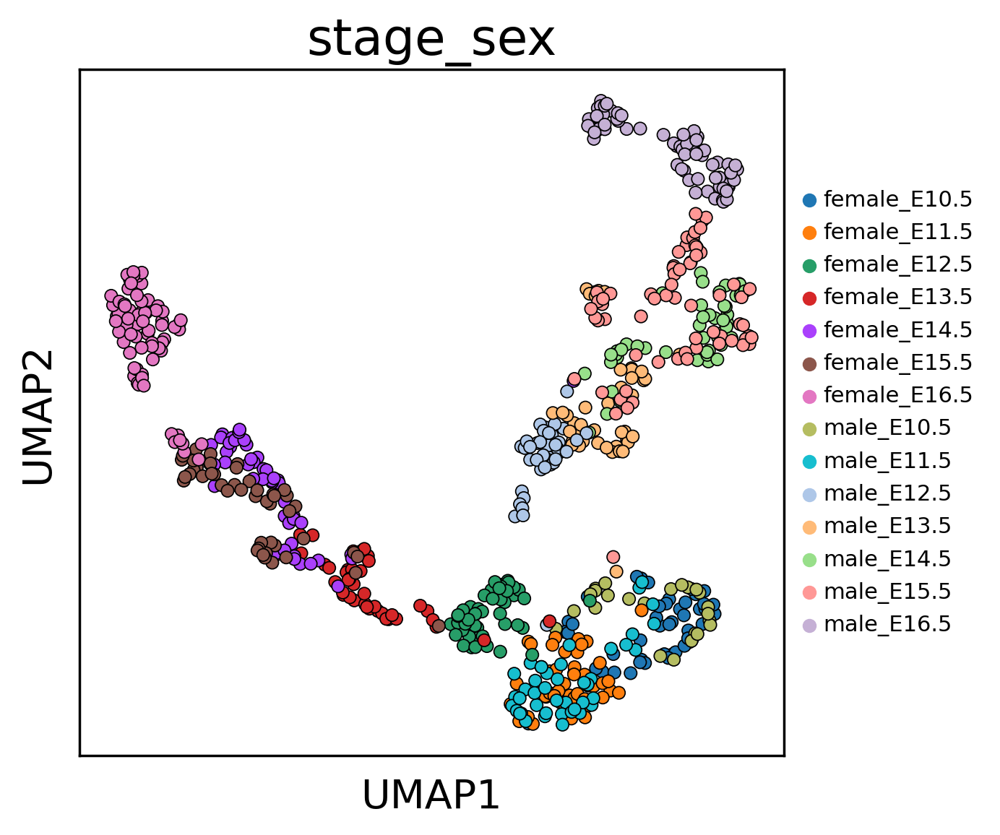

In [84]:
sc.pl.umap(gcAnndata, color=['stage_sex'], size=100, ec="black", linewidth=0.5, frameon=True)

In [85]:
sc.tl.tsne(gcAnndata, n_pcs=50, perplexity=40, random_state = 55063)

computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)


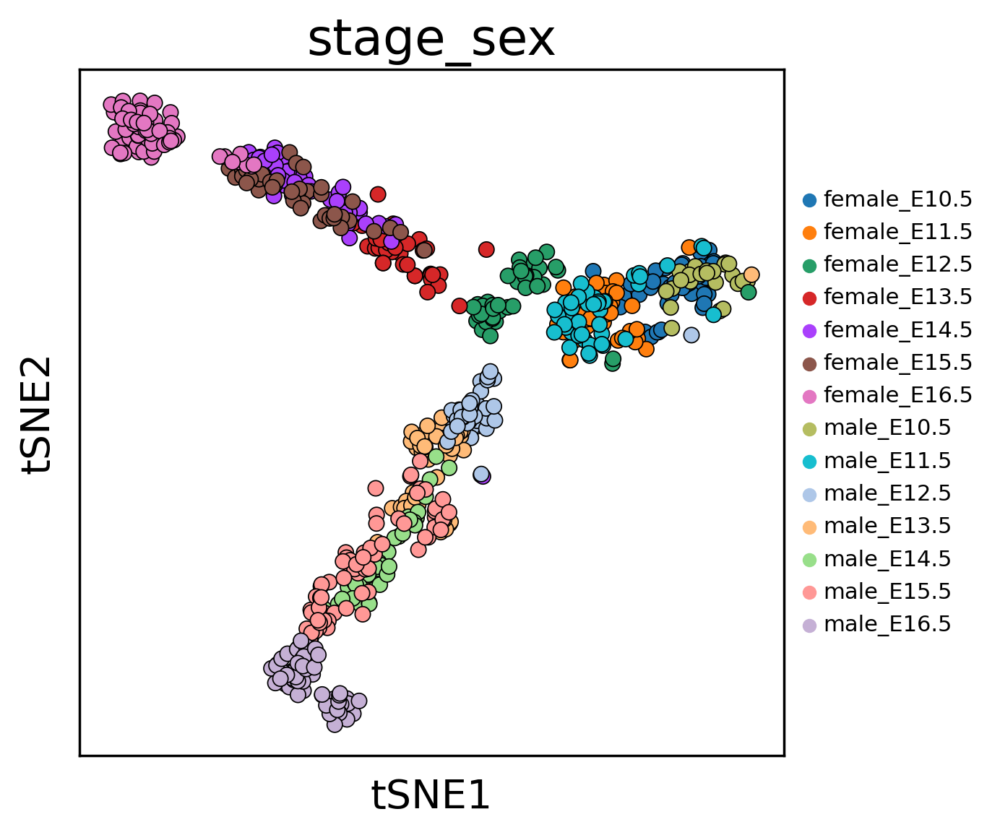

In [86]:
#plt.rcParams['figure.figsize'] = [5,5]
sc.pl.tsne(gcAnndata, color=['stage_sex'], size=150, ec="black", linewidth=0.5, frameon=True)#, save = '_stage_sex.png')

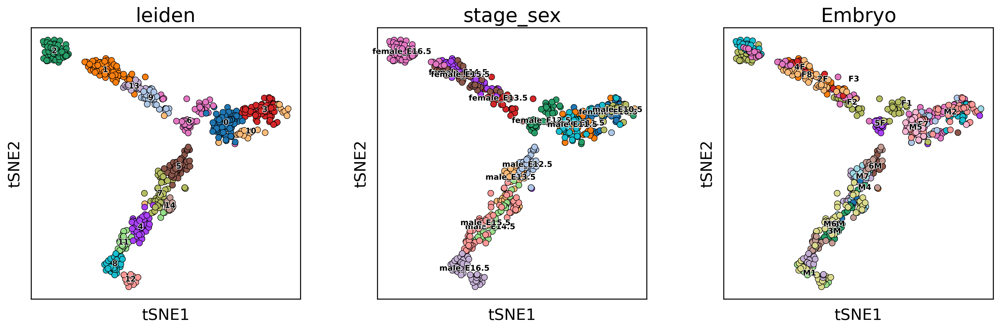

In [87]:
sc.pl.tsne(gcAnndata, color=["leiden", 'stage_sex', 'Embryo'],legend_loc="on data", size=150, edgecolor="black", linewidths=0.5, frameon=True, legend_fontsize=8, legend_fontoutline=1)

[<AxesSubplot: title={'center': 'sex'}, xlabel='tSNE1', ylabel='tSNE2'>,
 <AxesSubplot: title={'center': 'stage'}, xlabel='tSNE1', ylabel='tSNE2'>,
 <AxesSubplot: title={'center': 'stage_sex'}, xlabel='tSNE1', ylabel='tSNE2'>]

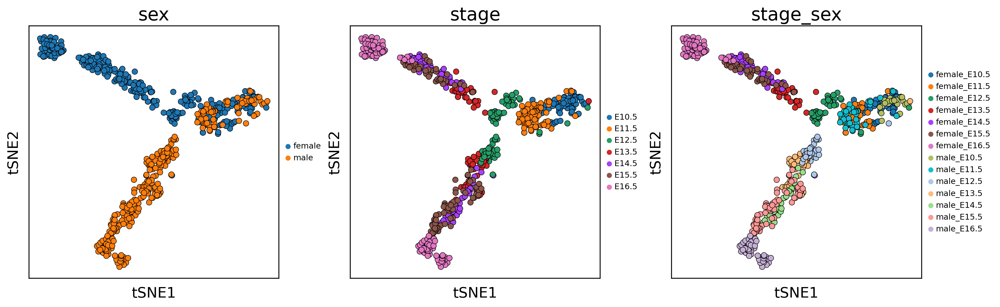

In [88]:
sc.pl.tsne(gcAnndata, color=['sex', 'stage', 'stage_sex'], size=150, ec="black", linewidth=0.5, frameon=True, show=False)#, save="_multi.png")

In [89]:
# colour scheme for nice plots
colours = ["#f1eef6", "#d4b9da", "#c994c7", "#df65b0", "#e7298a", "#ce1256", "#91003f", 
           "#eff3ff", "#c6dbef", "#9ecae1", "#6baed6", "#4292c6", "#2171b5", "#084594"]


cats = ["male_E10.5", "male_E11.5", "male_E12.5", "male_E13.5", "male_E14.5", "male_E15.5", "male_E16.5",
       "female_E10.5", "female_E11.5", "female_E12.5", "female_E13.5", "female_E14.5", "female_E15.5", "female_E16.5"]

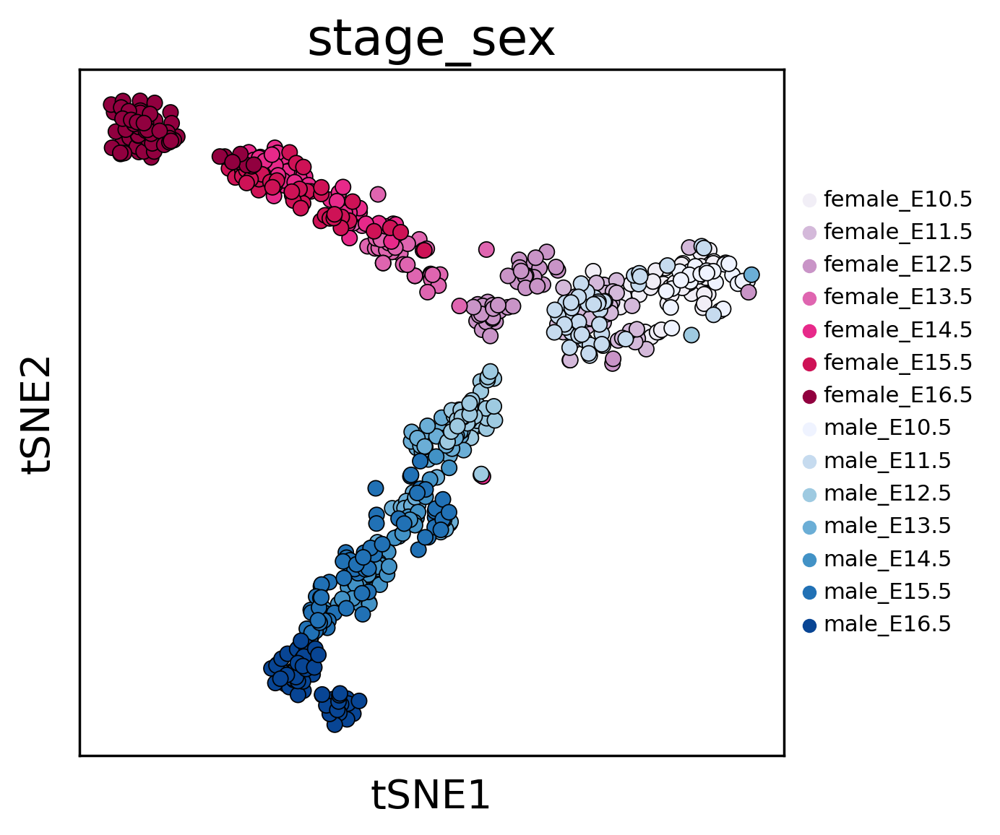

In [92]:
sc.pl.tsne(gcAnndata, color = ['stage_sex'], palette = colours, size = 150, ec = "black", linewidth = 0.5, frameon = True, save = '_stage_sex.pdf')

In [93]:
gcAnndata.obs.Sample = gcAnndata.obs.Sample.astype('category')

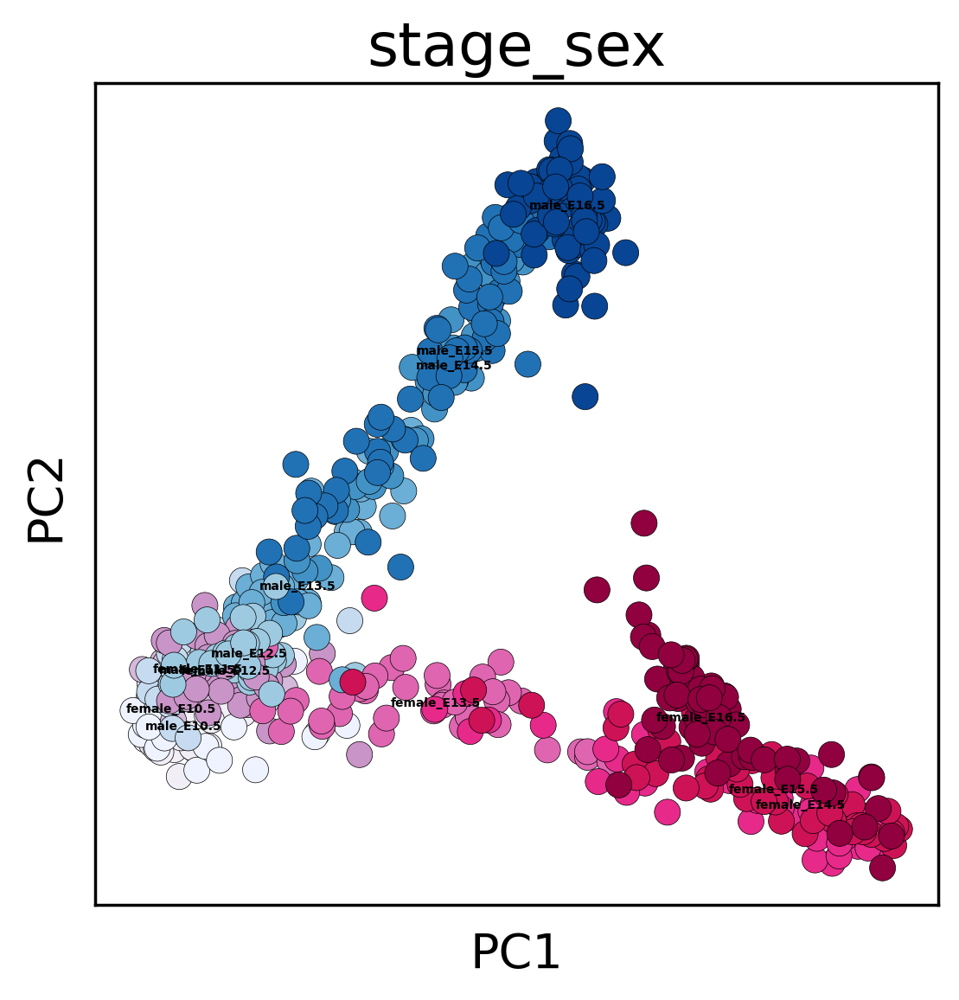

In [94]:
sc.pl.pca(gcAnndata, color='stage_sex', size=300, ec="black", frameon=True, legend_loc="on data", legend_fontsize=4, linewidth=0.2)

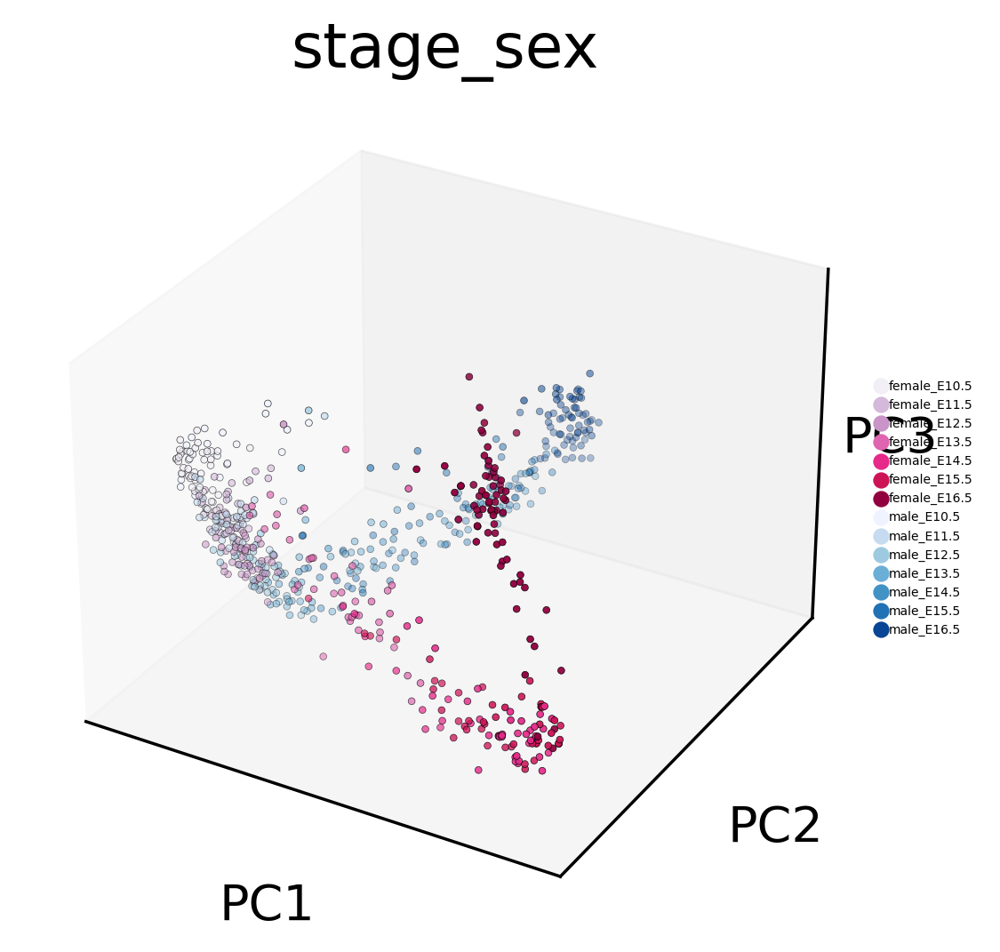

In [95]:
sc.pl.pca(gcAnndata, color='stage_sex', size=800, ec="black", frameon=True, legend_fontsize=4, linewidth=0.2, projection='3d')

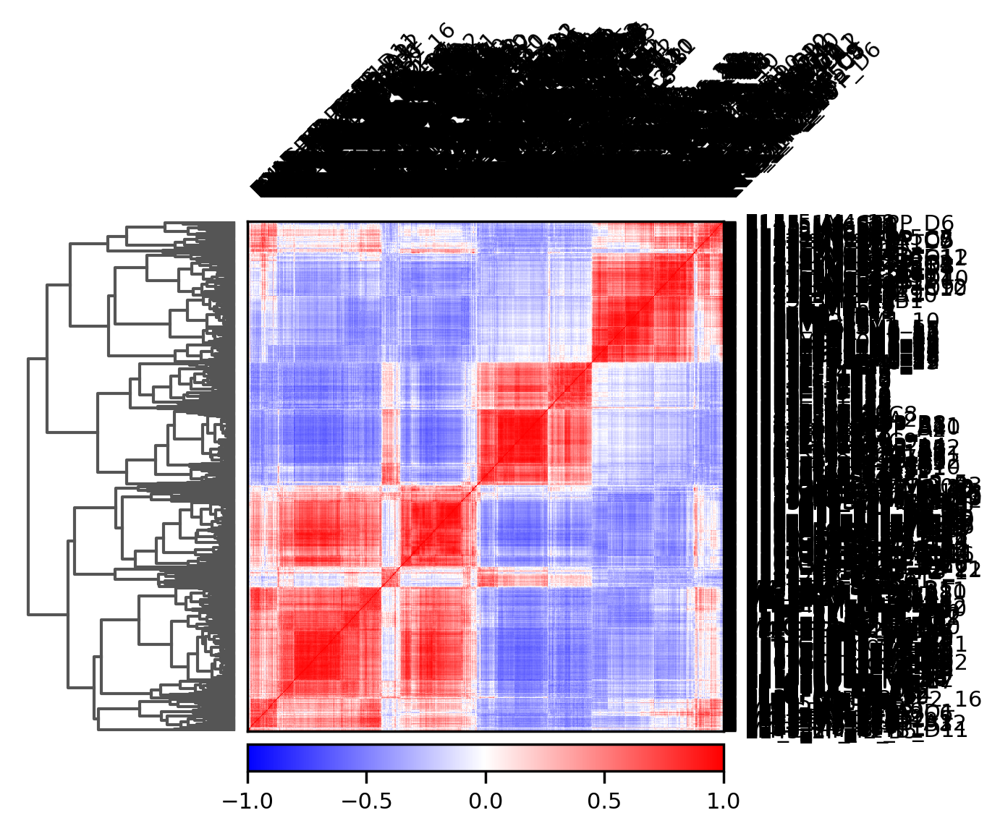

In [98]:
sc.pl.correlation_matrix(gcAnndata, groupby="Sample", figsize=[5,4])

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_stage_sex']`


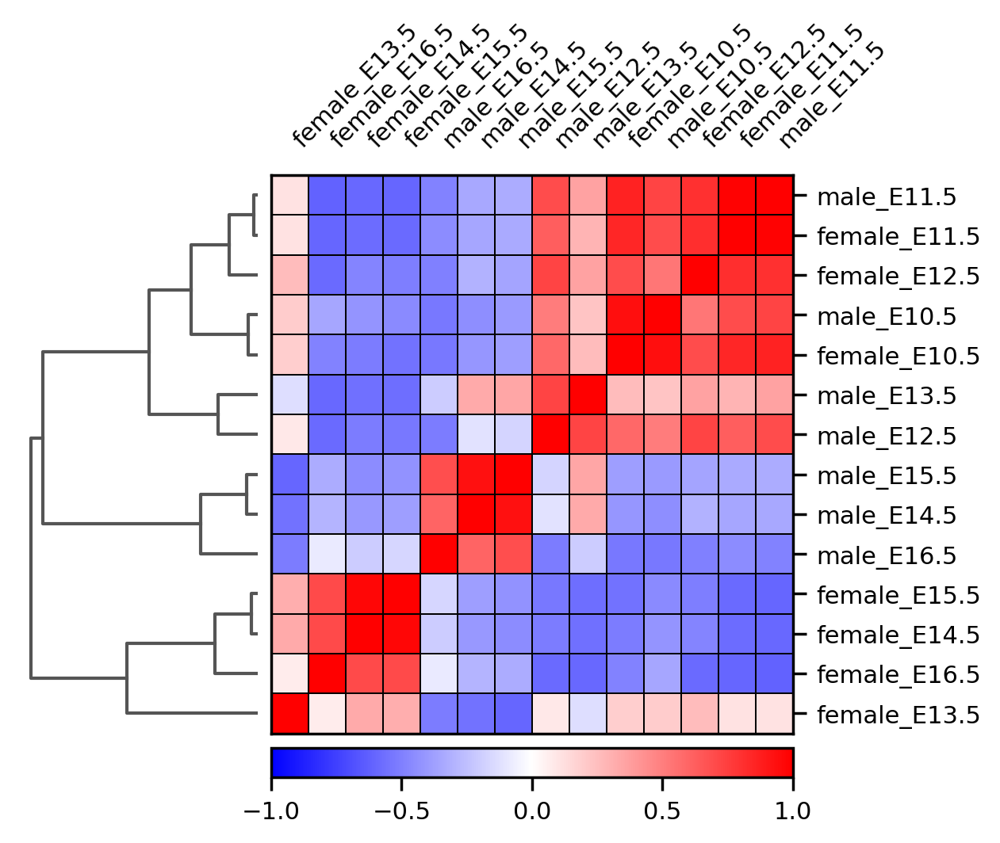

In [99]:
sc.pl.correlation_matrix(gcAnndata, groupby="stage_sex", 
                         figsize=[5,4])#,
                         #save="_stage_sex.pdf")

In [101]:
gcAnndata_f = gcAnndata[gcAnndata.obs.sex == 'female']

In [102]:
gcAnndata[:,gcAnndata.var[gcAnndata.var.chromosome_name == 'X'].geneid]

View of AnnData object with n_obs × n_vars = 681 × 734
    obs: 'Sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'sex', 'stage', 'Embryo', 'stage_sex', 'CellID', 'n_genes', 'n_counts', 'leiden'
    var: 'geneid', 'start_position', 'end_position', 'chromosome_name', 'external_gene_name', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Gene', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'log1p', 'hvg', 'pca', 'stage_sex_colors', 'neighbors', 'leiden', 'umap', 'tsne', 'leiden_colors', 'Embryo_colors', 'sex_colors', 'stage_colors', 'dendrogram_Sample', 'dendrogram_stage_sex'
    obsm: 'X_pca', 'X_umap', 'X_tsne'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [103]:
Xgenes = gcAnndata.var.index[gcAnndata.var.chromosome_name=="X"].to_list()
C9genes = gcAnndata.var.index[gcAnndata.var.chromosome_name=="9"].to_list()
Agenes = gcAnndata.var.index[~gcAnndata.var.chromosome_name.isin(['X', 'Y', 'mt'])].to_list()

In [104]:
len(Xgenes)

734

In [105]:
gcAnndata.obs["Chr X"] = (np.mean(gcAnndata[:, Xgenes].X, axis=1) / np.mean(gcAnndata[:, Agenes].X, axis=1)).tolist()

gcAnndata.obs["Chr 9"] = (np.mean(gcAnndata[:, C9genes].X, axis=1) / np.mean(gcAnndata[:, Agenes].X, axis=1)).tolist()

In [106]:
germXA_data = gcAnndata.obs["stage_sex"].to_frame().join(gcAnndata.obs["Chr 9"]).join(gcAnndata.obs["Chr X"])
#Melt the data to long format
germXA_data_melted = germXA_data.melt(id_vars="stage_sex", var_name="key", value_name="value")

In [107]:
germXA_data_melted.groupby(['stage_sex', 'key']).describe()

value                                                    \
                   count      mean       std       min       25%       50%   
stage_sex    key                                                             
female_E10.5 Chr 9  47.0  1.012043  0.026427  0.958342  0.989431  1.009407   
             Chr X  47.0  0.822947  0.070499  0.640044  0.782758  0.825400   
female_E11.5 Chr 9  47.0  1.029672  0.026420  0.975295  1.012752  1.025092   
             Chr X  47.0  0.847130  0.064805  0.654526  0.801558  0.862572   
female_E12.5 Chr 9  48.0  0.998605  0.045742  0.895704  0.973150  1.000592   
             Chr X  48.0  0.889870  0.092939  0.673507  0.827104  0.886237   
female_E13.5 Chr 9  40.0  1.044379  0.044534  0.930172  1.018523  1.053287   
             Chr X  40.0  0.992893  0.121615  0.733157  0.909683  0.978785   
female_E14.5 Chr 9  48.0  1.051697  0.051178  0.940974  1.015260  1.054081   
             Chr X  48.0  1.063192  0.122279  0.873746  0.970958  1.052641   
female_E15.5 Chr 9  47.0  1.037858  0.040084  0.943308  1.011347  1.041363   
             Chr X  47.0  1.035229  0.102241  0.812545  0.973312  1.026228   
female_E16.5 Chr 9  71.0  1.039123  0.045916  0.907251  1.017328  1.042530   
             Chr X  71.0  1.040803  0.110789  0.752412  0.969280  1.046088   
male_E10.5   Chr 9  24.0  1.038062  0.061847  0.970524  1.001445  1.020613   
             Chr X  24.0  0.773014  0.080408  0.593542  0.736125  0.773389   
male_E11.5   Chr 9  44.0  1.015869  0.033405  0.893333  1.000197  1.016201   
             Chr X  44.0  0.761341  0.052476  0.663016  0.730005  0.750823   
male_E12.5   Chr 9  40.0  1.001168  0.035163  0.934700  0.982239  1.001831   
             Chr X  40.0  0.691051  0.046065  0.590866  0.665667  0.687883   
male_E13.5   Chr 9  45.0  0.998012  0.041980  0.886521  0.974844  0.999950   
             Chr X  45.0  0.712141  0.078149  0.522520  0.679215  0.709172   
male_E14.5   Chr 9  48.0  1.023912  0.027087  0.977528  1.002257  1.020333   
             Chr X  48.0  0.784864  0.059649  0.652369  0.745806  0.791983   
male_E15.5   Chr 9  65.0  1.004693  0.031430  0.935337  0.982872  1.003668   
             Chr X  65.0  0.778226  0.068872  0.613075  0.740555  0.768841   
male_E16.5   Chr 9  67.0  1.035236  0.037549  0.956945  1.009372  1.034423   
             Chr X  67.0  0.660736  0.048407  0.526992  0.631664  0.659311   

                                        
                         75%       max  
stage_sex    key                        
female_E10.5 Chr 9  1.033937  1.077519  
             Chr X  0.877600  0.962569  
female_E11.5 Chr 9  1.044855  1.101905  
             Chr X  0.890400  0.973839  
female_E12.5 Chr 9  1.015991  1.169789  
             Chr X  0.959413  1.105513  
female_E13.5 Chr 9  1.073795  1.122464  
             Chr X  1.080452  1.396950  
female_E14.5 Chr 9  1.075947  1.180031  
             Chr X  1.141462  1.377386  
female_E15.5 Chr 9  1.061268  1.135436  
             Chr X  1.083537  1.352903  
female_E16.5 Chr 9  1.061850  1.247615  
             Chr X  1.123013  1.257005  
male_E10.5   Chr 9  1.040375  1.216107  
             Chr X  0.827852  0.906810  
male_E11.5   Chr 9  1.034641  1.102942  
             Chr X  0.802822  0.925153  
male_E12.5   Chr 9  1.024509  1.082474  
             Chr X  0.720373  0.819208  
male_E13.5   Chr 9  1.028868  1.079159  
             Chr X  0.767981  0.848880  
male_E14.5   Chr 9  1.043324  1.084641  
             Chr X  0.821869  0.938275  
male_E15.5   Chr 9  1.026745  1.085654  
             Chr X  0.811646  1.118926  
male_E16.5   Chr 9  1.055281  1.190011  
             Chr X  0.690349  0.774454

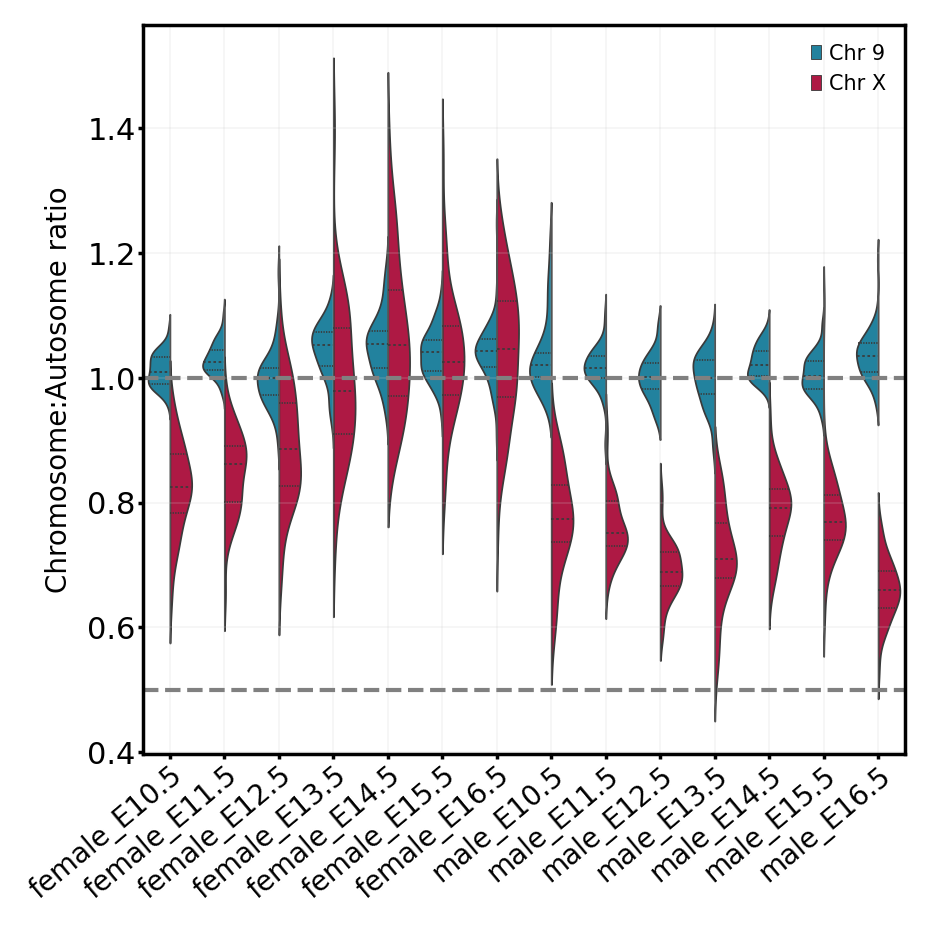

In [108]:
plt.rcParams["figure.figsize"]=4,4
bx = sns.violinplot(x="stage_sex", y="value",
            hue="key", palette=["#0D8DB3","#C70039"],fliersize=0.1,linewidth=0.5,split=True,scale="count",inner="quartile",
            data=germXA_data_melted)
bx.set(xlabel="")
bx.set_ylabel("Chromosome:Autosome ratio", fontsize=8)
bx.set_xticklabels(bx.get_xticklabels(), rotation=40, fontsize=8,horizontalalignment="right", rotation_mode="anchor", visible=True)
bx.grid(linestyle='-', linewidth='0.1')
bx.tick_params(
    axis="both",          # changes apply to the x-axis
    which="major",      # both major and minor ticks are affected
    bottom=True,      # ticks along the bottom edge are off
    top=False,  left=True, labeltop=False,      # ticks along the top edge are off
    labelbottom=True, pad=0.5, length=1.5)
bx.axhline(y=0.5,color='gray',linestyle='--')
bx.axhline(y=1,color='gray',linestyle='--')
plt.legend(loc="upper right", fontsize=6, frameon=False)
plt.tight_layout()

#figure = svm.get_figure()    
#plt.savefig('.../X_Aratios.pdf', dpi=600)

***Stats***

In [109]:
from scipy import stats

stats.mannwhitneyu(germXA_data_melted[germXA_data_melted['stage_sex'].str.contains('male') & germXA_data_melted['key'].isin(['Chr X'])].value,
              germXA_data_melted[germXA_data_melted['stage_sex'].str.contains('female') & germXA_data_melted['key'].isin(['Chr X'])].value)

MannwhitneyuResult(statistic=67915.0, pvalue=3.4661425085809535e-29)

In [110]:
stats.mannwhitneyu(germXA_data_melted[germXA_data_melted['stage_sex'].str.contains('male') & germXA_data_melted['key'].isin(['Chr 9'])].value,
              germXA_data_melted[germXA_data_melted['stage_sex'].str.contains('female') & germXA_data_melted['key'].isin(['Chr 9'])].value)

MannwhitneyuResult(statistic=106278.0, pvalue=0.006759871068865442)

In [ ]:
# plt.rcParams["figure.figsize"]=10,3
#p = sns.scatterplot(gcAnndata.obs.Sample, gcAnndata.obs['Chr X'], hue=gcAnndata.obs.sex, legend=False)
# plt.setp(p.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor");

In [111]:
stats.mannwhitneyu(germXA_data_melted[germXA_data_melted['stage_sex'].str.contains('female_E14.5') & germXA_data_melted['key'].isin(['Chr X'])].value,
              germXA_data_melted[germXA_data_melted['stage_sex'].str.contains('male_E14.5') & germXA_data_melted['key'].isin(['Chr X'])].value)
# At E14.5, female X output is significantly different to E14.5 male

MannwhitneyuResult(statistic=3446.0, pvalue=1.3128901010109332e-06)

In [112]:
stats.mannwhitneyu(germXA_data_melted[germXA_data_melted['stage_sex'].str.contains('female_E14.5') & germXA_data_melted['key'].isin(['Chr 9'])].value,
              germXA_data_melted[germXA_data_melted['stage_sex'].str.contains('male_E14.5') & germXA_data_melted['key'].isin(['Chr 9'])].value)
# At E14.5, female 9 output is NOT significantly different to E14.5 male

MannwhitneyuResult(statistic=2741.0, pvalue=0.06432346407530999)

In [113]:
stats.mannwhitneyu(germXA_data_melted[germXA_data_melted['stage_sex'].str.contains('female_E14.5') & germXA_data_melted['key'].isin(['Chr X'])].value,
              germXA_data_melted[germXA_data_melted['stage_sex'].str.contains('female_E14.5') & germXA_data_melted['key'].isin(['Chr 9'])].value)
# At E14.5, female X output is NOT significantly different to E14.5 female 9 output

MannwhitneyuResult(statistic=1131.0, pvalue=0.8805938792307255)

In [114]:
stats.mannwhitneyu(germXA_data_melted[germXA_data_melted['stage_sex'].str.contains('male_E14.5') & germXA_data_melted['key'].isin(['Chr X'])].value,
              germXA_data_melted[germXA_data_melted['stage_sex'].str.contains('male_E14.5') & germXA_data_melted['key'].isin(['Chr 9'])].value)
# At E14.5, male X output is significantly different to E14.5 male 9 output

MannwhitneyuResult(statistic=2465.0, pvalue=2.6222181827301973e-08)

**PAGA**

In [115]:
sc.tl.paga(gcAnndata, groups="stage_sex")
#sc.tl.paga(gcAnndata, groups="stage_sex_celltype")

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)


--> added 'pos', the PAGA positions (adata.uns['paga'])


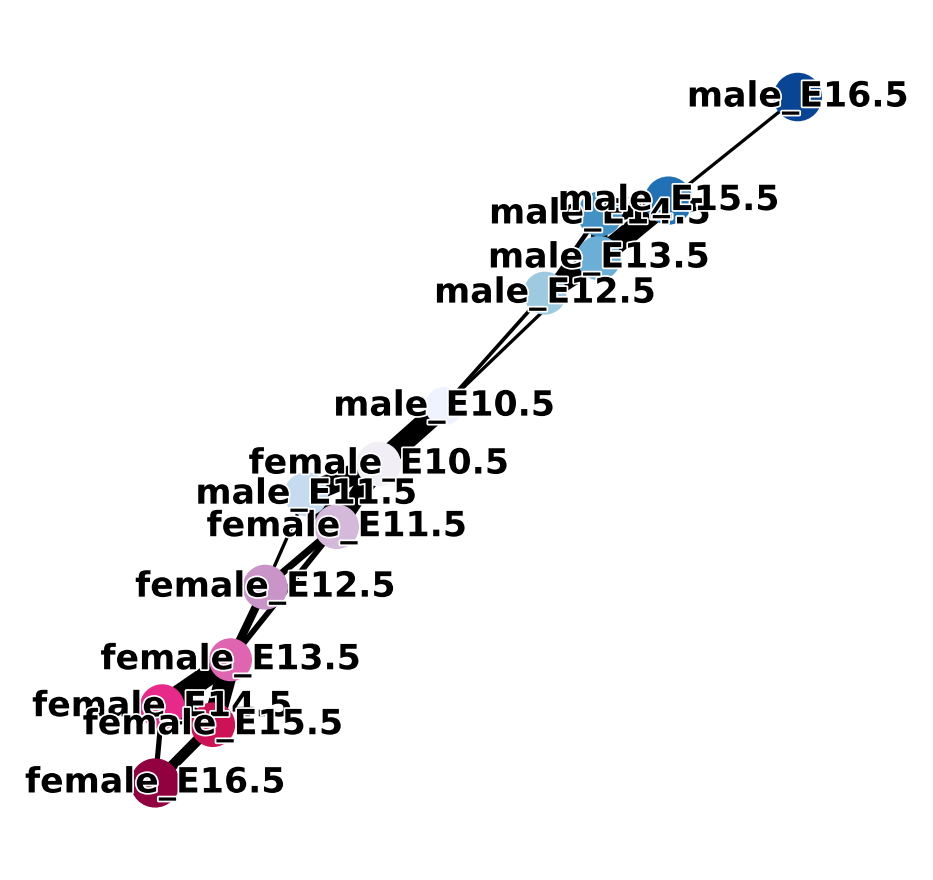

In [122]:
sc.pl.paga(gcAnndata,
           threshold = 0.1561, 
           fontsize=10,
           fontoutline=1, 
           layout='fa',
           save='_PAGA.pdf')

In [123]:
gcAnndata.uns['iroot'] = np.flatnonzero(gcAnndata.obs["stage_sex"]  == "male_E10.5")[0]

In [124]:
sc.tl.dpt(gcAnndata, 
          n_dcs = 15, 
          n_branchings = 2)

computing Diffusion Pseudotime using n_dcs=15
    this uses a hierarchical implementation
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs)
    'dpt_groups', the branching subgroups of dpt (adata.obs)
    'dpt_order', cell order (adata.obs) (0:00:00)


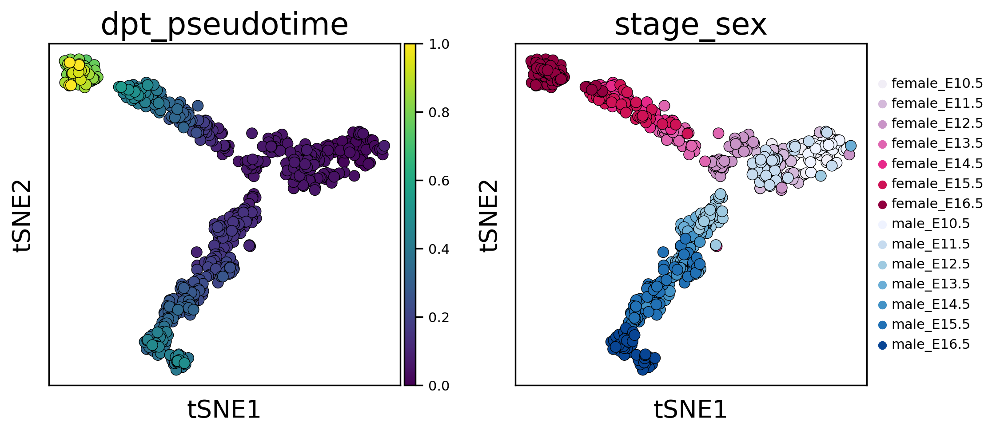

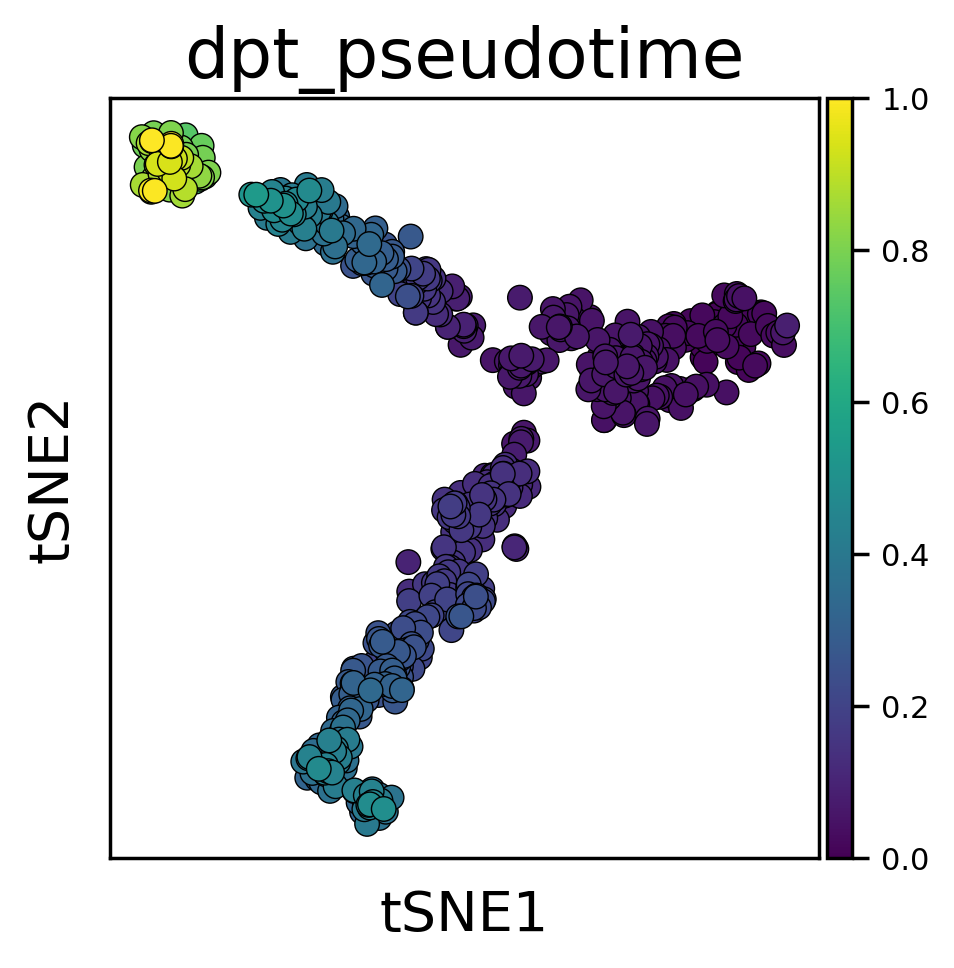

In [125]:
sc.pl.tsne(gcAnndata, color=["dpt_pseudotime", "stage_sex"], size=200,frameon=True, ec="black", linewidth=0.4)
sc.pl.tsne(gcAnndata, color=["dpt_pseudotime"], size=200,frameon=True, ec="black", linewidth=0.4)#, save = '_pseudotime.pdf')

## DE gene and marker analysis ##

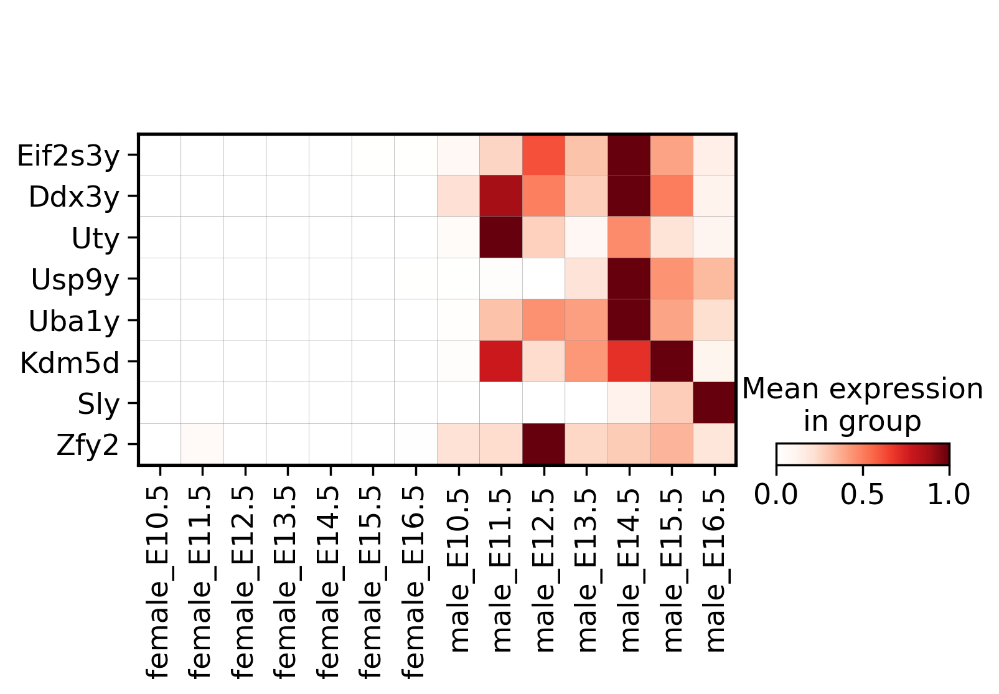

(None,)

In [149]:
sc.pl.matrixplot(gcAnndata, var_names=["Eif2s3y", "Ddx3y", "Uty", "Usp9y", "Uba1y", "Kdm5d", "Sly", "Zfy2"], 
                 gene_symbols="external_gene_name",
                 cmap=heatcolors_wr, 
                 groupby="stage_sex", 
                 #dendrogram = True,
                 swap_axes = True,
                 standard_scale="var"),
                 #save = '.../_Ygenes.png')

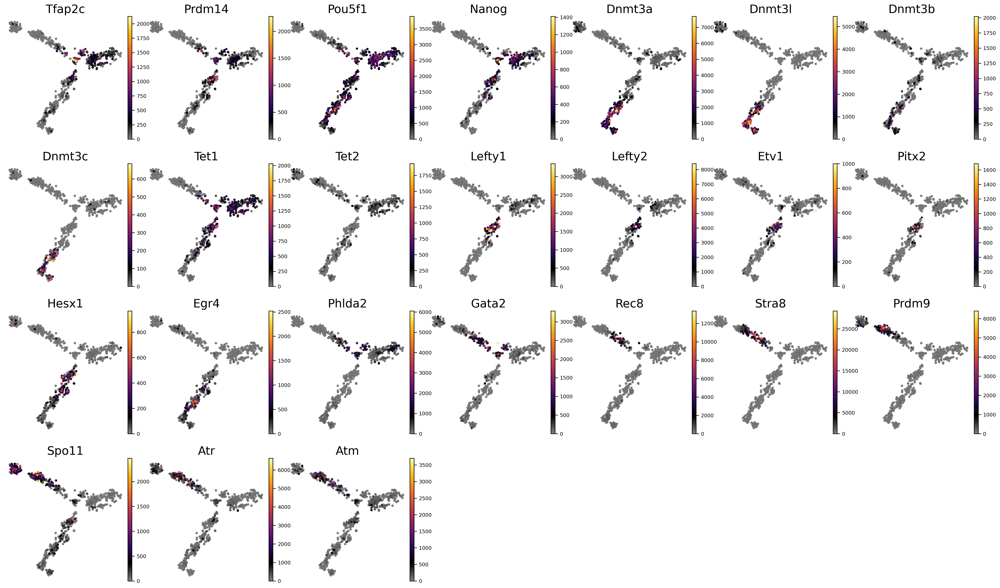

In [153]:
#gcAnndata.var
sc.pl.tsne(gcAnndata, 
           color=["Tfap2c", "Prdm14", "Pou5f1", "Nanog", "Dnmt3a", "Dnmt3l", "Dnmt3b", "Dnmt3c", "Tet1", "Tet2", "Lefty1", "Lefty2", "Etv1",
                  "Pitx2", "Hesx1", "Egr4", "Phlda2", "Gata2", "Rec8", "Stra8", "Prdm9", "Spo11", "Atr", "Atm"], 
           gene_symbols = 'external_gene_name', 
           use_raw=True, 
           legend_fontsize=6, 
           size=60, 
           edgecolor="black", 
           linewidths=0.1,
           wspace=0.05, 
           hspace=0.2, 
           cmap=heatcolors, 
           ncols=7)#,
           #save="_male_female_candidategenes")

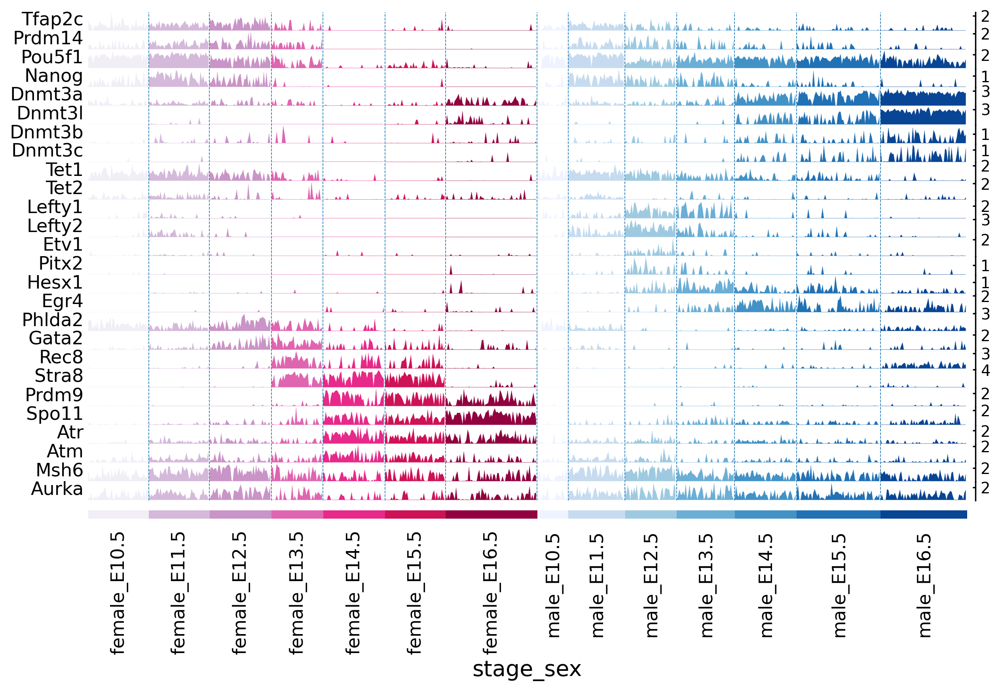

In [155]:
#gcAnndata.var
sc.pl.tracksplot(gcAnndata, var_names=["Tfap2c", "Prdm14", "Pou5f1", "Nanog", 
                                       "Dnmt3a", "Dnmt3l", "Dnmt3b", "Dnmt3c", "Tet1", "Tet2", 
                                       "Lefty1", "Lefty2", "Etv1", "Pitx2", "Hesx1", "Egr4", 
                                       "Phlda2", "Gata2", "Rec8", "Stra8", "Prdm9", "Spo11", 
                                       "Atr", "Atm", "Msh6", "Aurka"], 
                 gene_symbols = 'external_gene_name', 
                 use_raw=False, 
                 dendrogram=False,
                 groupby='stage_sex',
                 #save = "tracksplot_malefemale.pdf",
                 )

In [157]:
%%R -o Ezh2_derep_X
Ezh2_derep_X <- read.delim("~/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_17Jul23/Table_fem_chrx.txt")
Ezh2_derep_All <- read.delim("~/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_17Jul23/Table_fem.txt")




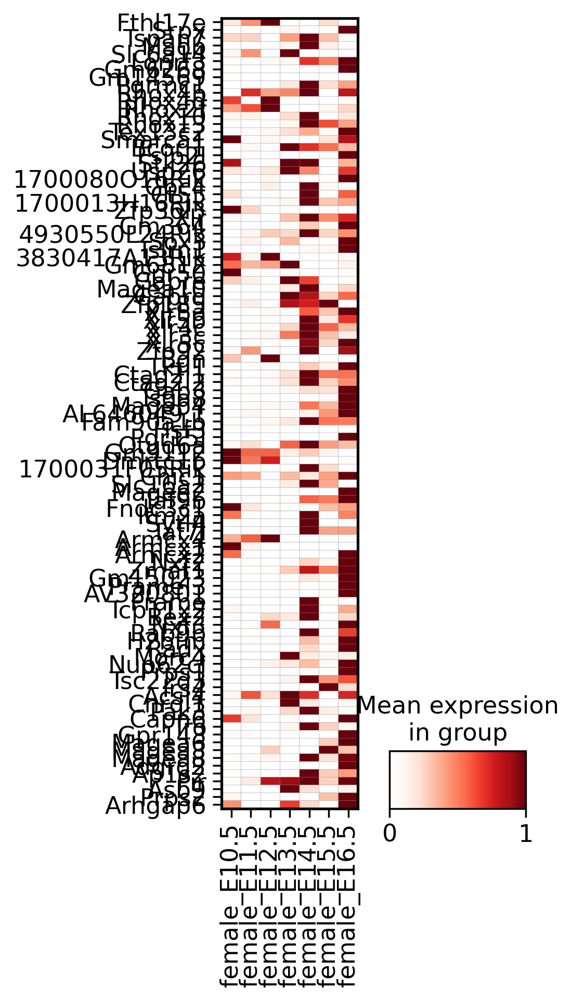

In [159]:
sc.pl.matrixplot(gcAnndata_f, 
                 var_names = gcAnndata_f.var[gcAnndata_f.var.geneid.isin(Ezh2_derep_X.ensembl_gene_id)].external_gene_name,
                 gene_symbols="external_gene_name",
                 cmap=heatcolors_wr, 
                 groupby="stage_sex", 
                 #dendrogram = True,
                 swap_axes = True,
                 standard_scale="var",
                 figsize = [3,8], save="_Ezh2_derep_X.pdf")

In [168]:
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", 
                        groups=["female_E16.5", "female_E15.5", "female_E14.5", "female_E13.5", "female_E12.5", "female_E11.5", "female_E10.5"], 
                        reference = 'rest', 
                        method='wilcoxon', 
                        tie_correct=True, 
                        key_added="female", 
                        pts=True)

ranking genes
    finished: added to `.uns['female']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:08)


In [169]:
sc.tl.rank_genes_groups(gcAnndata, 
                        groupby="stage_sex", 
                        groups=["male_E16.5", "male_E15.5", "male_E14.5", "male_E13.5", "male_E12.5", "male_E11.5", "male_E10.5"], 
                        reference = 'rest', 
                        method='wilcoxon', 
                        tie_correct=True, 
                        key_added="male", 
                        pts=True)

ranking genes
    finished: added to `.uns['male']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


In [170]:
## Male E16.5
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["male_E16.5"], reference = "male_E15.5", method='wilcoxon', tie_correct=True, key_added="male", pts=True)
m_df_E16_5 = sc.get.rank_genes_groups_df(gcAnndata, group="male_E16.5", key="male", pval_cutoff=0.01, log2fc_min = 1.5, gene_symbols="external_gene_name")
m_df_E16_5[1:20]
## Male E15.5
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["male_E15.5"], reference = "male_E14.5", method='wilcoxon', tie_correct=True, key_added="male", pts=True)
m_df_E15_5 = sc.get.rank_genes_groups_df(gcAnndata, group="male_E15.5", key="male", pval_cutoff=0.01, log2fc_min = 1.5, gene_symbols="external_gene_name")
m_df_E15_5[1:20]
## Male E14.5
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["male_E14.5"], reference = "male_E13.5", method='wilcoxon', tie_correct=True, key_added="male", pts=True)
m_df_E14_5 = sc.get.rank_genes_groups_df(gcAnndata, group="male_E14.5", key="male", pval_cutoff=0.01, log2fc_min = 1.5, gene_symbols="external_gene_name")
m_df_E14_5[1:20]
## Male E13.5
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["male_E13.5"], reference = "male_E12.5", method='wilcoxon', tie_correct=True, key_added="male", pts=True)
m_df_E13_5 = sc.get.rank_genes_groups_df(gcAnndata, group="male_E13.5", key="male", pval_cutoff=0.01, log2fc_min = 1.5, gene_symbols="external_gene_name")
m_df_E13_5[1:20]
## Male E12.5 
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["male_E12.5"], reference = "male_E11.5", method='wilcoxon', tie_correct=True, key_added="male", pts=True)
m_df_E12_5 = sc.get.rank_genes_groups_df(gcAnndata, group="male_E12.5", key="male", pval_cutoff=0.01, log2fc_min = 1.5, gene_symbols="external_gene_name")
m_df_E12_5[1:20]
## Male E11.5 
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["male_E11.5"], reference = "male_E10.5", method='wilcoxon', tie_correct=True, key_added="male", pts=True)
m_df_E11_5 = sc.get.rank_genes_groups_df(gcAnndata, group="male_E11.5", key="male", pval_cutoff=0.01, log2fc_min = 1.5, gene_symbols="external_gene_name")
m_df_E11_5[1:20]


ranking genes
    finished: added to `.uns['male']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes
    finished: added to `.uns['male']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes
    finished: added to `.uns['male']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted

,names,scores,logfoldchanges,pvals,pvals_adj,external_gene_name,pct_nz_group
1,ENSMUSG00000056234,6.565826,213.050735,5.174525e-11,2.406918e-07,Ncoa4,1.000000
2,ENSMUSG00000039678,6.559144,553.579590,5.411766e-11,2.406918e-07,Tbc1d13,1.000000
3,ENSMUSG00000017119,6.552553,358.968750,5.656180e-11,2.406918e-07,Nbr1,1.000000
4,ENSMUSG00000004056,6.527918,203.101013,6.669024e-11,2.406918e-07,Akt2,1.000000
5,ENSMUSG00000031976,6.522604,383.036194,6.909717e-11,2.406918e-07,Urb2,0.977273
6,ENSMUSG00000002996,6.501409,232.760284,7.957129e-11,2.406918e-07,Hbp1,1.000000
7,ENSMUSG00000020211,6.459280,220.519241,1.052023e-10,2.784441e-07,Sf3a2,0.977273
8,ENSMUSG00000005672,6.404060,inf,1.512987e-10,3.559553e-07,Kit,1.000000
9,ENSMUSG00000030091,6.378636,359.181885,1.786723e-10,3.783207e-07,Nup210,1.000000
10,ENSMUSG00000025324,6.329055,187.015335,2.466673e-10,4.396694e-07,Atp10a,1.000000


In [172]:
## Female E16.5
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["female_E16.5"], reference = "female_E15.5", method='wilcoxon', tie_correct=True, key_added="female", pts=True)
f_df_E16_5 = sc.get.rank_genes_groups_df(gcAnndata, group="female_E16.5", key="female", pval_cutoff=0.01, log2fc_min = 1.5, gene_symbols="external_gene_name")
f_df_E16_5[1:20]
## Female E15.5
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["female_E15.5"], reference = "female_E14.5", method='wilcoxon', tie_correct=True, key_added="female", pts=True)
f_df_E15_5 = sc.get.rank_genes_groups_df(gcAnndata, group="female_E15.5", key="female", pval_cutoff=0.01, log2fc_min = 1.5, gene_symbols="external_gene_name")
f_df_E15_5[1:20]
## Female E14.5
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["female_E14.5"], reference = "female_E13.5", method='wilcoxon', tie_correct=True, key_added="female", pts=True)
f_df_E14_5 = sc.get.rank_genes_groups_df(gcAnndata, group="female_E14.5", key="female", pval_cutoff=0.01, log2fc_min = 1.5, gene_symbols="external_gene_name")
f_df_E14_5[1:20]
## Female E13.5
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["female_E13.5"], reference = "female_E12.5", method='wilcoxon', tie_correct=True, key_added="female", pts=True)
f_df_E13_5 = sc.get.rank_genes_groups_df(gcAnndata, group="female_E13.5", key="female", pval_cutoff=0.01, log2fc_min = 1.5, gene_symbols="external_gene_name")
f_df_E13_5[1:20]
## Female E12.5 
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["female_E12.5"], reference = "female_E11.5", method='wilcoxon', tie_correct=True, key_added="female", pts=True)
f_df_E12_5 = sc.get.rank_genes_groups_df(gcAnndata, group="female_E12.5", key="female", pval_cutoff=0.01, log2fc_min = 1.5, gene_symbols="external_gene_name")
f_df_E12_5[1:20]
## Male E11.5 
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["female_E11.5"], reference = "female_E10.5", method='wilcoxon', tie_correct=True, key_added="female", pts=True)
f_df_E11_5 = sc.get.rank_genes_groups_df(gcAnndata, group="female_E11.5", key="female", pval_cutoff=0.01, log2fc_min = 1.5, gene_symbols="external_gene_name")
f_df_E11_5[1:20]

ranking genes
    finished: added to `.uns['female']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes
    finished: added to `.uns['female']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes
    finished: added to `.uns['female']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', 

,names,scores,logfoldchanges,pvals,pvals_adj,external_gene_name,pct_nz_group
1,ENSMUSG00000005672,7.853261,inf,4.053579e-15,4.291524e-11,Kit,1.000000
2,ENSMUSG00000035632,7.566010,296.673340,3.848639e-14,2.716370e-10,Cnot3,1.000000
3,ENSMUSG00000024949,7.512884,631.347900,5.783882e-14,3.061698e-10,Sf1,1.000000
4,ENSMUSG00000036097,7.430614,229.695465,1.080946e-13,4.144266e-10,Slf2,1.000000
5,ENSMUSG00000016933,7.419645,474.032745,1.174346e-13,4.144266e-10,Plcg1,1.000000
6,ENSMUSG00000003435,7.380548,446.897797,1.576390e-13,4.525582e-10,Supt5,1.000000
7,ENSMUSG00000026024,7.365295,280.987885,1.767555e-13,4.525582e-10,Als2,1.000000
8,ENSMUSG00000030662,7.354002,inf,1.923597e-13,4.525582e-10,Ipo5,1.000000
9,ENSMUSG00000028430,7.286180,529.008667,3.188652e-13,6.143860e-10,Nol6,1.000000
10,ENSMUSG00000030082,7.286049,694.304688,3.191767e-13,6.143860e-10,Sec61a1,1.000000


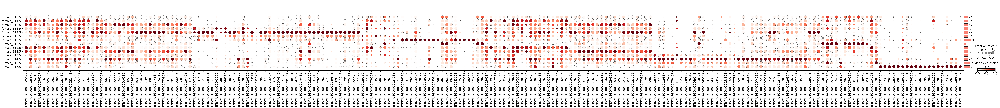

In [191]:
sc.pl.DotPlot(gcAnndata, 
                 pd.concat([f_df_E11_5[1:20].names, f_df_E12_5[1:20].names, f_df_E13_5[1:20].names, f_df_E14_5[1:20].names, f_df_E15_5[1:20].names, f_df_E16_5[1:20].names, 
                            m_df_E11_5[1:20].names, m_df_E12_5[1:20].names, m_df_E13_5[1:20].names, m_df_E14_5[1:20].names, m_df_E15_5[1:20].names, m_df_E16_5[1:20].names], axis = 0).reset_index(drop=True),
                 cmap=heatcolors_wr,
                 groupby="stage_sex",
                 #swap_axes = False, 
                 #dendrogram = False,
                 standard_scale = "var").add_totals().show()

GO_f11_5 = sc.queries.enrich(f_df_E11_5.dropna(axis=0)["names"].to_list(), org="mmusculus")
GO_f12_5 = sc.queries.enrich(f_df_E12_5.dropna(axis=0)["names"].to_list(), org="mmusculus")
GO_f13_5 = sc.queries.enrich(f_df_E13_5.dropna(axis=0)["names"].to_list(), org="mmusculus")
GO_f14_5 = sc.queries.enrich(f_df_E14_5.dropna(axis=0)["names"].to_list(), org="mmusculus")
GO_f15_5 = sc.queries.enrich(f_df_E15_5.dropna(axis=0)["names"].to_list(), org="mmusculus")
GO_f16_5 = sc.queries.enrich(f_df_E16_5.dropna(axis=0)["names"].to_list(), org="mmusculus")

GO_m11_5 = sc.queries.enrich(m_df_E11_5.dropna(axis=0)["names"].to_list(), org="mmusculus")
GO_m12_5 = sc.queries.enrich(m_df_E12_5.dropna(axis=0)["names"].to_list(), org="mmusculus")
GO_m13_5 = sc.queries.enrich(m_df_E13_5.dropna(axis=0)["names"].to_list(), org="mmusculus")
GO_m14_5 = sc.queries.enrich(m_df_E14_5.dropna(axis=0)["names"].to_list(), org="mmusculus")
GO_m15_5 = sc.queries.enrich(m_df_E15_5.dropna(axis=0)["names"].to_list(), org="mmusculus")
GO_m16_5 = sc.queries.enrich(m_df_E16_5.dropna(axis=0)["names"].to_list(), org="mmusculus")

## Male v Female gslist

In [192]:
sc.tl.rank_genes_groups(gcAnndata, 'stage_sex', method='wilcoxon')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


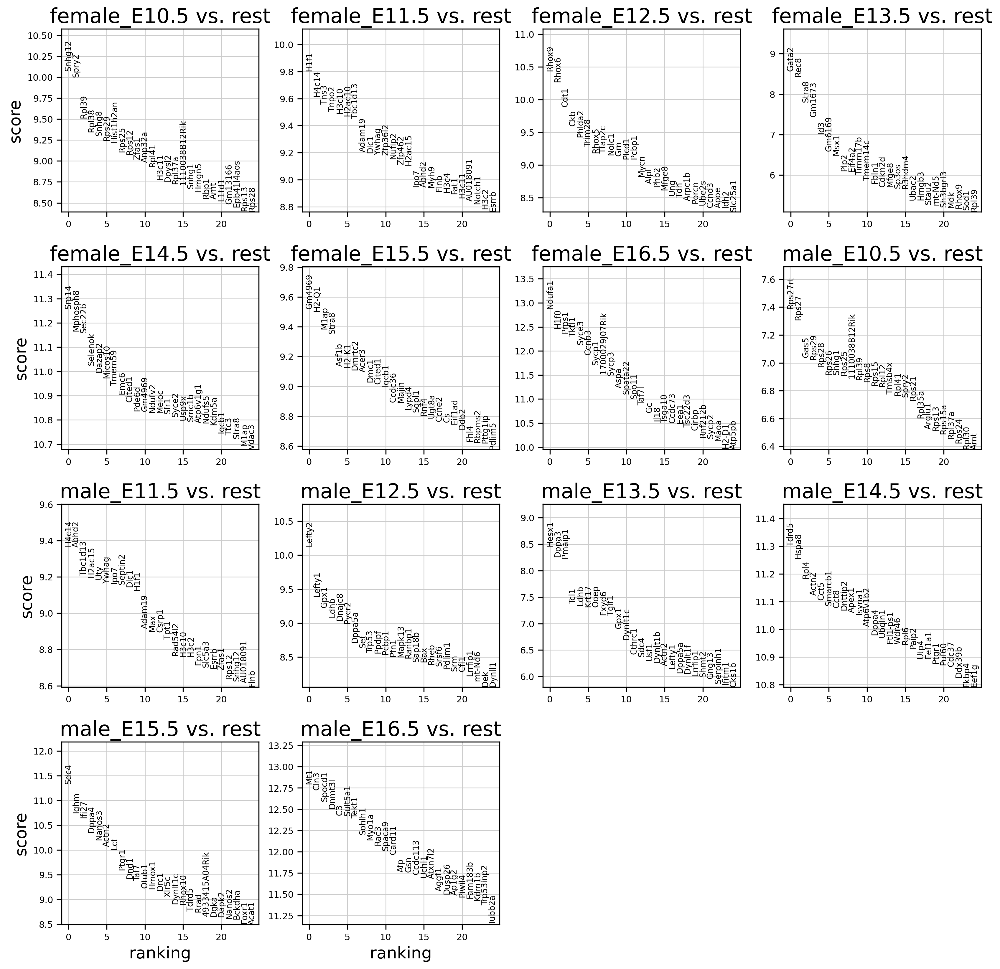

In [193]:
sc.pl.rank_genes_groups(gcAnndata, n_genes=25, sharey=False, gene_symbols="external_gene_name")

In [177]:
result = gcAnndata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores', 'logfoldchanges', 'pvals_adj']}).head(50)

,female_E10.5_n,female_E10.5_s,female_E10.5_l,female_E10.5_p,female_E11.5_n,female_E11.5_s,female_E11.5_l,female_E11.5_p,female_E12.5_n,female_E12.5_s,female_E12.5_l,female_E12.5_p,female_E13.5_n,female_E13.5_s,female_E13.5_l,female_E13.5_p,female_E14.5_n,female_E14.5_s,female_E14.5_l,female_E14.5_p,female_E15.5_n,female_E15.5_s,female_E15.5_l,female_E15.5_p,female_E16.5_n,female_E16.5_s,female_E16.5_l,female_E16.5_p,male_E10.5_n,male_E10.5_s,male_E10.5_l,male_E10.5_p,male_E11.5_n,male_E11.5_s,male_E11.5_l,male_E11.5_p,male_E12.5_n,male_E12.5_s,male_E12.5_l,male_E12.5_p,male_E13.5_n,male_E13.5_s,male_E13.5_l,male_E13.5_p,male_E14.5_n,male_E14.5_s,male_E14.5_l,male_E14.5_p,male_E15.5_n,male_E15.5_s,male_E15.5_l,male_E15.5_p,male_E16.5_n,male_E16.5_s,male_E16.5_l,male_E16.5_p
0,ENSMUSG00000086290,10.071825,356.789215,5.194648e-20,ENSMUSG00000049539,9.802875,328.357483,2.317000e-18,ENSMUSG00000068048,10.435003,inf,3.633613e-21,ENSMUSG00000015053,8.568956,634.627197,2.211137e-13,ENSMUSG00000009549,11.258389,inf,4.458666e-25,ENSMUSG00000085601,9.520860,inf,5.195239e-18,ENSMUSG00000016427,12.876844,inf,6.433672e-34,ENSMUSG00000050621,7.388151,90.319962,1.050828e-09,ENSMUSG00000091405,9.368430,121.183609,8.214427e-17,ENSMUSG00000066652,10.129660,inf,8.640414e-20,ENSMUSG00000040726,8.459110,227.576523,5.704808e-13,ENSMUSG00000060985,11.299863,inf,2.317641e-25,ENSMUSG00000017009,11.332695,inf,1.913708e-25,ENSMUSG00000031765,12.796465,inf,6.055304e-34
1,ENSMUSG00000022114,9.996903,161.074356,8.323366e-20,ENSMUSG00000091405,9.613456,166.443558,7.427192e-18,ENSMUSG00000006200,10.269109,inf,1.027970e-20,ENSMUSG00000002324,8.430614,inf,3.640409e-13,ENSMUSG00000079184,11.165549,inf,4.622438e-25,ENSMUSG00000079507,9.502802,79.002922,5.407765e-18,ENSMUSG00000096210,12.460629,inf,5.183393e-32,ENSMUSG00000090733,7.307340,NaN,1.442389e-09,ENSMUSG00000039202,9.362884,286.835846,8.214427e-17,ENSMUSG00000038793,9.385757,inf,6.613246e-17,ENSMUSG00000046323,8.259953,NaN,1.315307e-12,ENSMUSG00000015656,11.254965,NaN,2.317641e-25,ENSMUSG00000076617,10.747350,inf,6.456875e-23,ENSMUSG00000030720,12.726160,inf,1.119960e-33
2,ENSMUSG00000079641,9.510871,inf,4.448272e-18,ENSMUSG00000020422,9.556976,266.121613,8.557630e-18,ENSMUSG00000006585,9.891661,inf,3.193462e-19,ENSMUSG00000029848,7.799374,inf,4.391134e-11,ENSMUSG00000027879,11.157939,inf,4.622438e-25,ENSMUSG00000030041,9.383311,NaN,1.041319e-17,ENSMUSG00000031432,12.366297,inf,1.052723e-31,ENSMUSG00000053332,7.038497,inf,5.696867e-09,ENSMUSG00000039678,9.204022,479.034088,1.413284e-16,ENSMUSG00000063856,9.227533,NaN,1.954609e-16,ENSMUSG00000024521,8.230549,216.246826,1.315307e-12,ENSMUSG00000032399,11.184193,NaN,3.439491e-25,ENSMUSG00000064215,10.645263,inf,1.294905e-22,ENSMUSG00000028784,12.590128,inf,5.066626e-33
3,ENSMUSG00000057322,9.343737,inf,1.640859e-17,ENSMUSG00000031691,9.503186,322.096161,9.954063e-18,ENSMUSG00000001270,9.599442,NaN,4.254817e-18,ENSMUSG00000070858,7.443162,399.929077,5.203667e-10,ENSMUSG00000042682,11.024386,inf,1.543055e-24,ENSMUSG00000029848,9.354879,inf,1.225165e-17,ENSMUSG00000031397,12.289491,inf,1.985609e-31,ENSMUSG00000034892,7.024236,NaN,5.696867e-09,ENSMUSG00000063021,9.194911,62.954388,1.413284e-16,ENSMUSG00000030246,9.083806,NaN,5.549853e-16,ENSMUSG00000041359,7.371583,inf,8.008315e-10,ENSMUSG00000052374,11.123314,inf,4.512018e-25,ENSMUSG00000058550,10.347286,NaN,2.278925e-21,ENSMUSG00000000730,12.507071,inf,1.032946e-32
4,ENSMUSG00000104960,9.299936,131.445847,2.288909e-17,ENSMUSG00000101355,9.488202,43.106407,9.954063e-18,ENSMUSG00000010760,9.426699,inf,1.792162e-17,ENSMUSG00000007872,7.014052,NaN,9.804120e-09,ENSMUSG00000000346,10.993567,inf,1.737889e-24,ENSMUSG00000005470,9.133571,inf,6.378795e-17,ENSMUSG00000078938,12.128869,756.731567,1.123250e-30,ENSMUSG00000067288,6.969834,NaN,7.351964e-09,ENSMUSG00000068457,9.186591,72.683029,1.413284e-16,ENSMUSG00000054405,9.034102,inf,7.002407e-16,ENSMUSG00000030246,7.340220,NaN,8.008315e-10,ENSMUSG00000022234,11.105812,

In [179]:
DE_female_E105 = sc.get.rank_genes_groups_df(gcAnndata, group='female_E10.5', pval_cutoff=0.05, log2fc_min=1.588, key="rank_genes_groups", gene_symbols="external_gene_name").sort_values(by=["scores"], ascending=[False])
DE_female_E115 = sc.get.rank_genes_groups_df(gcAnndata, group='female_E11.5', pval_cutoff=0.05, log2fc_min=1.588, key="rank_genes_groups", gene_symbols="external_gene_name").sort_values(by=["scores"], ascending=[False])
DE_female_E125 = sc.get.rank_genes_groups_df(gcAnndata, group='female_E12.5', pval_cutoff=0.05, log2fc_min=1.588, key="rank_genes_groups", gene_symbols="external_gene_name").sort_values(by=["scores"], ascending=[False])
DE_female_E135 = sc.get.rank_genes_groups_df(gcAnndata, group='female_E13.5', pval_cutoff=0.05, log2fc_min=1.588, key="rank_genes_groups", gene_symbols="external_gene_name").sort_values(by=["scores"], ascending=[False])
DE_female_E145 = sc.get.rank_genes_groups_df(gcAnndata, group='female_E14.5', pval_cutoff=0.05, log2fc_min=1.588, key="rank_genes_groups", gene_symbols="external_gene_name").sort_values(by=["scores"], ascending=[False])
DE_female_E155 = sc.get.rank_genes_groups_df(gcAnndata, group='female_E15.5', pval_cutoff=0.05, log2fc_min=1.588, key="rank_genes_groups", gene_symbols="external_gene_name").sort_values(by=["scores"], ascending=[False])
DE_female_E165 = sc.get.rank_genes_groups_df(gcAnndata, group='female_E16.5', pval_cutoff=0.05, log2fc_min=1.588, key="rank_genes_groups", gene_symbols="external_gene_name").sort_values(by=["scores"], ascending=[False])
sc.tl.rank_genes_groups(gcAnndata, groupby="stage_sex", groups=["female_E16.5"], reference = "female_E13.5", method='wilcoxon', tie_correct=True, key_added="female", pts=True)
DE_female_E165vE135 = sc.get.rank_genes_groups_df(gcAnndata, group="female_E16.5", key="female", pval_cutoff=0.05, log2fc_min=1.588, gene_symbols="external_gene_name")


ranking genes
    finished: added to `.uns['female']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


In [180]:
#DE_female_E165vE135 = sc.get.rank_genes_groups_df(gcAnndata,
#                                                  group="female_E16.5", 
#                                                  key="female",
#                                                  pval_cutoff=0.01, 
#                                                  log2fc_min=2,
#                                                  gene_symbols="external_gene_name").sort_values(by=["scores"], ascending=[False]).dropna(axis=0)#["external_gene_name"].to_list())
DE_female_E165vE135[DE_female_E165vE135.pvals_adj<0.05]

,names,scores,logfoldchanges,pvals,pvals_adj,external_gene_name,pct_nz_group
0,ENSMUSG00000031397,8.812840,inf,1.220150e-18,3.690778e-15,Tktl1,1.000000
1,ENSMUSG00000096210,8.531160,inf,1.448876e-17,2.788955e-14,H1f0,0.985915
2,ENSMUSG00000009596,8.432611,inf,3.380348e-17,4.771699e-14,Taf7l,1.000000
3,ENSMUSG00000051592,8.376738,763.262146,5.441513e-17,6.064137e-14,Ccnb3,0.957746
4,ENSMUSG00000031432,8.178836,inf,2.865999e-16,2.758394e-13,Prps1,0.943662
...,...,...,...,...,...,...,...
1646,ENSMUSG00000032913,2.639403,72.368431,8.305215e-03,4.984542e-02,Lrig2,0.788732
1647,ENSMUSG00000024521,2.638535,39.953098,8.326498e-03,4.995899e-02,Pmaip1,0.267606
1648,ENSMUSG00000026005,2.638428,49.923851,8.329134e-03,4.996064e-02,Rpe,0.605634
1649,ENSMUSG00000045382,-2.687850,2.531237,7.191361e-03,4.471949e-02,Cxcr4,0.070423


In [ ]:
gcAnndata.write_h5ad("/users/k2142342/Lab_Sangrithi/working/Mahesh_Sangrithi/GermCell_SmartSeq2/FeatureCounts_OUT_17Jul23//gcAnndata_reproduce.h5ad")

In [198]:
sc.tl.rank_genes_groups(gcAnndata, 'stage_sex', method='wilcoxon')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


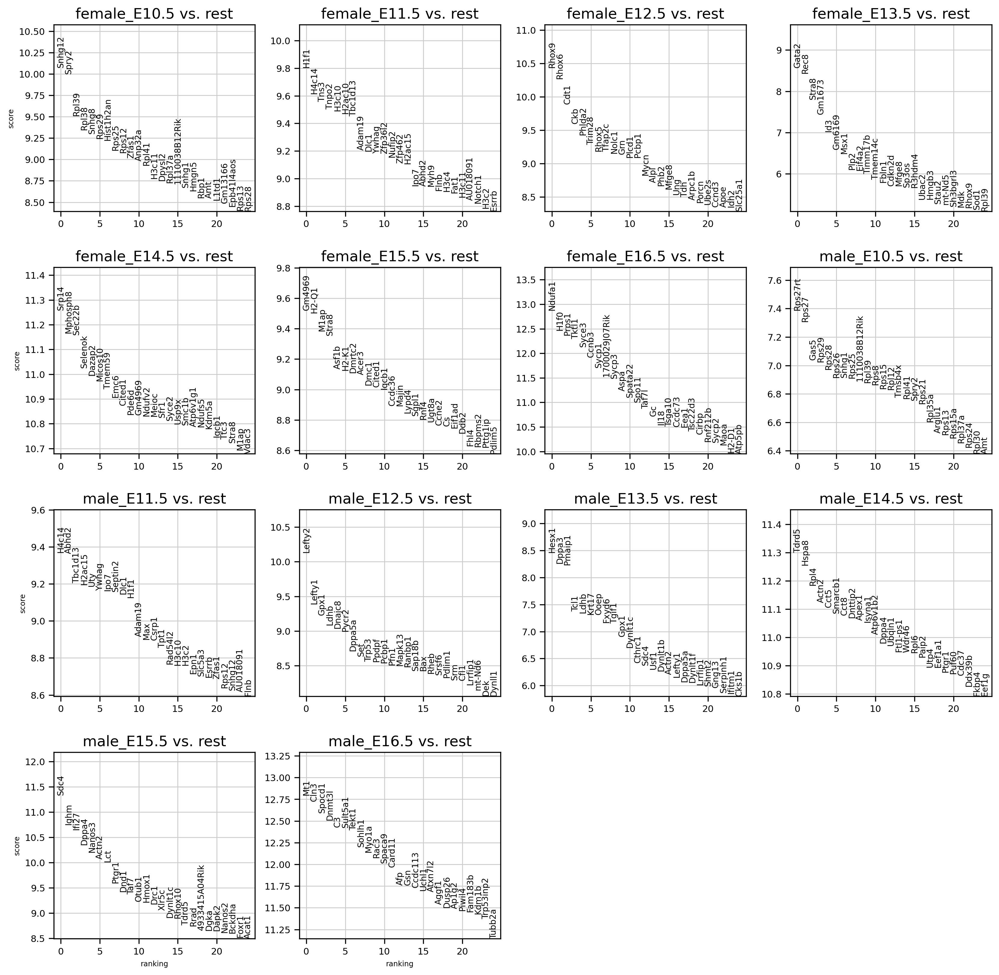

In [199]:
sc.pl.rank_genes_groups(gcAnndata, n_genes=25, sharey=False, gene_symbols='external_gene_name',)

In [ ]:
#sc.get.rank_genes_groups_df(gcAnndata, group='male_E12.5', 
#                                        pval_cutoff=0.00001, 
#                                        log2fc_min=1.5,
#                                        gene_symbols="external_gene_name",
#                                        key="rank_genes_groups").sort_values(by=["scores"], 
#                                        ascending=[False]).dropna(axis=0)["external_gene_name"].to_list()

In [220]:
gslist = {}
for i in ['male_E10.5', 'female_E10.5', 'male_E11.5', 'female_E11.5', 'male_E12.5', 'female_E12.5', 'male_E13.5', 'female_E13.5', 'male_E14.5', 'female_E14.5', 'male_E15.5', 'female_E15.5', 'male_E16.5', 'female_E16.5']:
    genes = sc.get.rank_genes_groups_df(gcAnndata, 
                                        group = i, 
                                        pval_cutoff=0.01, 
                                        log2fc_min=2,
                                        gene_symbols="external_gene_name",
                                        key="rank_genes_groups").sort_values(by=["scores"], 
                                        ascending=[False]).dropna(axis=0)["external_gene_name"].to_list()
    gslist[i] = genes

In [221]:
top10 = pd.Series(gslist['male_E11.5'][:10] + gslist['male_E12.5'][:10] + gslist['male_E13.5'][:10] + gslist['male_E14.5'][:10] + gslist['male_E15.5'][:10] + gslist['male_E16.5'][:10] + gslist['female_E11.5'][:10] + gslist['female_E12.5'][:10] + gslist['female_E13.5'][:10] + gslist['female_E14.5'][:10] + gslist['female_E15.5'][:10] + gslist['female_E16.5'][:10], name = 'top10')
top10.drop_duplicates()

0              H4c14
1              Abhd2
2            Tbc1d13
3             H2ac15
4                Uty
           ...      
115            Ccnb3
116            Sycp1
117    1700029J07Rik
118            Sycp3
119             Aspa
Name: top10, Length: 110, dtype: object

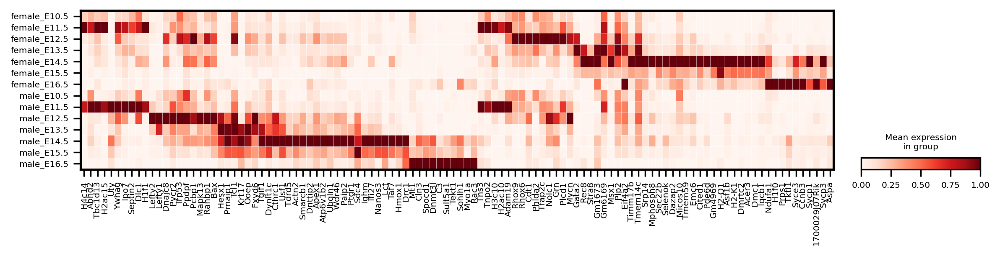

In [223]:
sns.set_context("paper", font_scale=1, rc={"font.size":7,"axes.labelsize":7,"axes.titlesize":14})
d = sc.pl.matrixplot(gcAnndata,
                     top10.drop_duplicates(), 
                     cmap = 'Reds', 
                     groupby = "stage_sex", 
                     standard_scale="var", 
                     gene_symbols='external_gene_name', 
                     edgecolor="white", 
                     linewidths=-0,
                     #swap_axes = True, 
                     figsize = [11,2],
                     #save = "male_female_top10_horiz.pdf",
                     )